In [ ]:
# 1- single run each sample :
# code and data: /scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/single_run

In [ ]:
# 3- CONGAS 
# code and data : /scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/single_run 

In [ ]:
# 4- GEX data Aggregation

#code and data:
# /scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/row_version_Gex
# /scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED

# DE GEX and HOTSPOT: /home/fatemeh.nasrabadi/ROVIGO_congas/final/gex_aggregation/THESIS GEX DE seq and HOT spot on all tumors




#tumor:
#row 

#FINALIZED

In [ ]:
# UMAP, Signature analysis --> /home/fatemeh.nasrabadi/ROVIGO_congas/final/PLOT2_finalized_gex_visualization RUN2
#PTPRZ1

# code and data

In [ ]:
# DEA, pathway enrichment, HOTSPOT  --> /home/fatemeh.nasrabadi/ROVIGO_congas/final/gex_aggregation/DE seq and HOT spot on all tumors

#code and data


In [1]:
import scanpy as sc

import muon as mu

from muon import atac as ac
from muon import prot as pt

import scipy
import numpy as np 
import pandas as pd

from matplotlib import pyplot as plt
import seaborn as sns

import pandas as pd

In [2]:
def write_dataset(data, path, sep='\t', header=True, index=True, compression=None):
    """
    See pandas.to_csv documentation - this is just a wrapper
    :param data: data to save
    :param path: str or Path object, path to save
    :param sep:
    :param header:
    :param index:
    :param compression:
    :return:
    """
    from pathlib import Path

    if isinstance(path, str):
        path = Path(path)

    output_dir = path.parents[0]
    output_dir.mkdir(parents=True, exist_ok=True)

    return data.to_csv(
        path, sep=sep, header=header, index=index, compression=compression
    )

In [3]:
tumor= sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_row_FINAL_afteratac8121.h5ad")

In [4]:
tumor

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source'

In [5]:
!ls /scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/

10Samples_agg_ATAC_tumor_rowmatrix.h5ad  DGE
10Samples_agg_FINALIZED.h5ad		 Plots_all_tumor.ipynb
10Samples_agg_gex_raw.h5ad		 Tumor_after_check_atac.h5ad
10Samples_agg_raw_filtered.h5ad		 Tumor_row_FINAL_afteratac8121.h5ad
allPLOT_Umap.h5ad			 Tumor_Umap_harmoney8121.h5ad


In [2]:
all_data = sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/10Samples_agg_FINALIZED.h5ad")

In [4]:
all_data.obs["site"]

AAACAGCCACCCTCAC-1_BTROHT06_Peri    Peri
AAACATGCATTAGGCC-1_BTROHT06_Peri    Peri
AAACCGAAGGCCGGAA-1_BTROHT06_Peri    Peri
AAACCGCGTCTATCGT-1_BTROHT06_Peri    Peri
AAACCGCGTTACCGGG-1_BTROHT06_Peri    Peri
                                    ... 
TTTGTGAAGCTAGAAG-1_BTROHT06_Core    Core
TTTGTGGCAACTAGGG-1_BTROHT06_Core    Core
TTTGTGTTCCAATTAG-1_BTROHT06_Core    Core
TTTGTTGGTAATGACT-1_BTROHT06_Core    Core
TTTGTTGGTTCATCTA-1_BTROHT06_Core    Core
Name: site, Length: 32313, dtype: category
Categories (2, object): ['Core', 'Peri']

In [7]:
all_data.obs["Bigannotation"]

AAACAGCCACCCTCAC-1_BTROHT06_Peri    Oligodendrocytes
AAACATGCATTAGGCC-1_BTROHT06_Peri    Oligodendrocytes
AAACCGAAGGCCGGAA-1_BTROHT06_Peri    Oligodendrocytes
AAACCGCGTCTATCGT-1_BTROHT06_Peri    Oligodendrocytes
AAACCGCGTTACCGGG-1_BTROHT06_Peri    Microglial cells
                                          ...       
TTTGTGAAGCTAGAAG-1_BTROHT06_Core    Microglial cells
TTTGTGGCAACTAGGG-1_BTROHT06_Core    Microglial cells
TTTGTGTTCCAATTAG-1_BTROHT06_Core         Tumor cells
TTTGTTGGTAATGACT-1_BTROHT06_Core         Tumor cells
TTTGTTGGTTCATCTA-1_BTROHT06_Core         Tumor cells
Name: Bigannotation, Length: 32313, dtype: category
Categories (8, object): ['Astrocytes', 'Inhibitory neurons', 'Microglial cells', 'Excitatory neurons', 'Oligodendrocytes', 'T cells', 'Tumor cells', 'OPCs']

In [11]:
import pandas as pd

# Count cells per site and cell type
count_df = pd.crosstab(
    all_data.obs["Bigannotation"],  # cell types
    all_data.obs["site"]            # Core / Peri
)

# Total number of cells in each site
total_core = count_df["Core"].sum()
total_peri = count_df["Peri"].sum()

# Calculate percentages
percent_df = pd.DataFrame({
    "Core_%": (count_df["Core"] / total_core) * 100,
    "Peri_%": (count_df["Peri"] / total_peri) * 100
})

# Optional: round
percent_df = percent_df.round(2)

percent_df


,Core_%,Peri_%
Bigannotation,,
Astrocytes,0.38,1.53
Inhibitory neurons,4.49,8.37
Microglial cells,16.16,17.80
Excitatory neurons,5.32,14.71
Oligodendrocytes,4.78,51.36
T cells,0.55,0.53
Tumor cells,67.86,2.96
OPCs,0.45,2.73


In [12]:
import pandas as pd

number_table = pd.crosstab(
    all_data.obs["Bigannotation"],  # cell types
    all_data.obs["site"]            # Core / Peri
)

number_table


site,Core,Peri
Bigannotation,,
Astrocytes,43,323
Inhibitory neurons,504,1764
Microglial cells,1816,3752
Excitatory neurons,598,3101
Oligodendrocytes,537,10826
T cells,62,112
Tumor cells,7625,623
OPCs,51,576


In [6]:
##colors

In [8]:
cell_type_colors = {
    "Oligodendrocytes":"#a8db96", #"#c9e5b9",  # light green
    "Tumor cells": "#1b519b",      # blue 
    "Microglial cells": "#e996a7",        # pink 
    "Excitatory neurons": "#8566a9",  # green 
    "Inhibitory neurons": "#b67b88",  # orange-yellow 
    "OPCs": "#aed8ea",              # pale blue 
    "Astrocytes": "#b22725",        # red
    "T cells": "#f07e27"           # orange
}


In [9]:
patient_colors = {
    "BTROHT03": "#96e6b3",  # Mint Green (replacement for white)
    "BTROHT04": "#235789",  # Steel Blue
    "BTROHT06": "#ffc126",  # Golden Yellow
    "BTROHT01": "#c1292e",  # Warm Red
    "BTROHT02": "#161925"   # Deep Navy
}


site_colors = {
    "Core": "#ef6c7c",         # Coral Pink
    "Peri": "#77b5d9"          # Sharper Sky Blue
}


In [10]:
patient_zone_colors = {
    "BTROHT01_Core": "#003a7d",   # Dark Blue
    "BTROHT01_Peri": "#008dff",   # Med Blue
    "BTROHT02_Core": "#ff73b6",   # Pink
    "BTROHT02_Peri": "#122740",   # Purple
    "BTROHT03_Core": "#4ecb8d",   # Green
    "BTROHT03_Peri": "#ff9d3a",   # Orange
    "BTROHT04_Core": "#9d2c00",
    "BTROHT04_Peri": "#d83034",   # Red
    "BTROHT06_Core": "#a63cff",   # Extra 1 (Sharp Violet)
    "BTROHT06_Peri": "#00c2b8",   # Extra 2 (Teal)
}


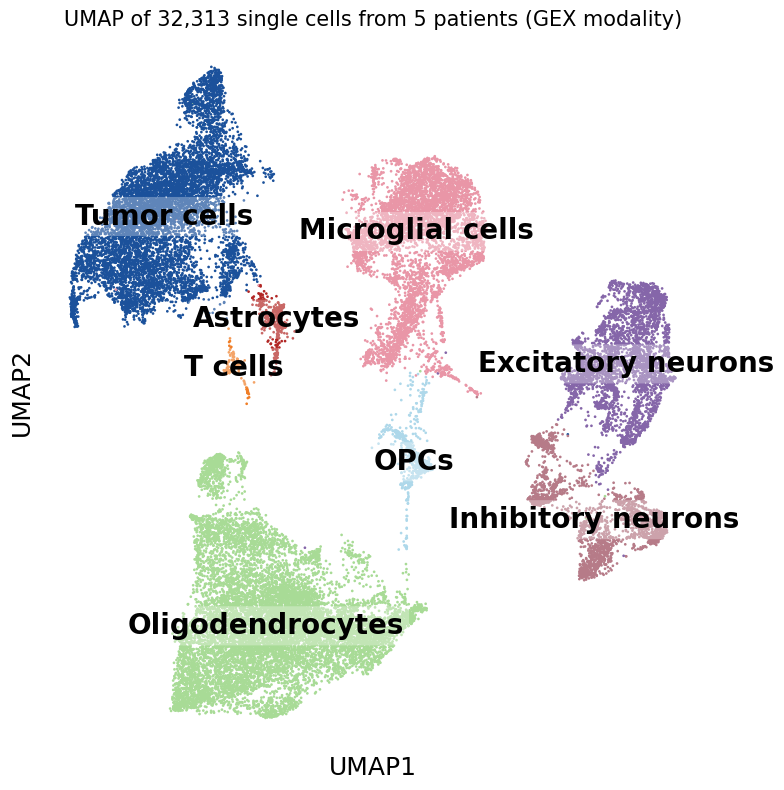

In [10]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

# Ensure the annotation is categorical
all_data.obs["Bigannotation"] = all_data.obs["Bigannotation"].astype("category")

# Apply custom colors
all_data.uns["Bigannotation_colors"] = [
    cell_type_colors[ct] for ct in all_data.obs["Bigannotation"].cat.categories
]

# Plot and capture figure
fig = sc.pl.umap(
    all_data,
    color='Bigannotation',
    size=15,
    frameon=True,
    return_fig=True
)

# Resize figure
fig.set_size_inches(8, 8)

# Access Axes
ax = fig.axes[0]

# Set axis labels
ax.set_xlabel("UMAP1", fontsize=18)
ax.set_ylabel("UMAP2", fontsize=18)

# ✅ Add a title for the full UMAP
ax.set_title("UMAP of 32,313 single cells from 5 patients (GEX modality)", fontsize=15)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# ❌ Remove default legend
if ax.get_legend() is not None:
    ax.get_legend().remove()

# ✅ Add labels directly on the UMAP
# Get coordinates
umap_df = all_data.obsm["X_umap"]
labels = all_data.obs["Bigannotation"]

# Convert to DataFrame for easier handling
df = pd.DataFrame(umap_df, columns=["UMAP1", "UMAP2"])
df["label"] = labels.values

# Compute median coordinates per label and place text
for label in df["label"].unique():
    x = df.loc[df["label"] == label, "UMAP1"].median()
    y = df.loc[df["label"] == label, "UMAP2"].median()
    ax.text(
        x, y, label,
        fontsize=20,
        weight='bold',
        ha='center',
        va='center',
        bbox=dict(facecolor='white', alpha=0.3, edgecolor='none', boxstyle='round,pad=0.2')
    )

plt.tight_layout()
plt.show()


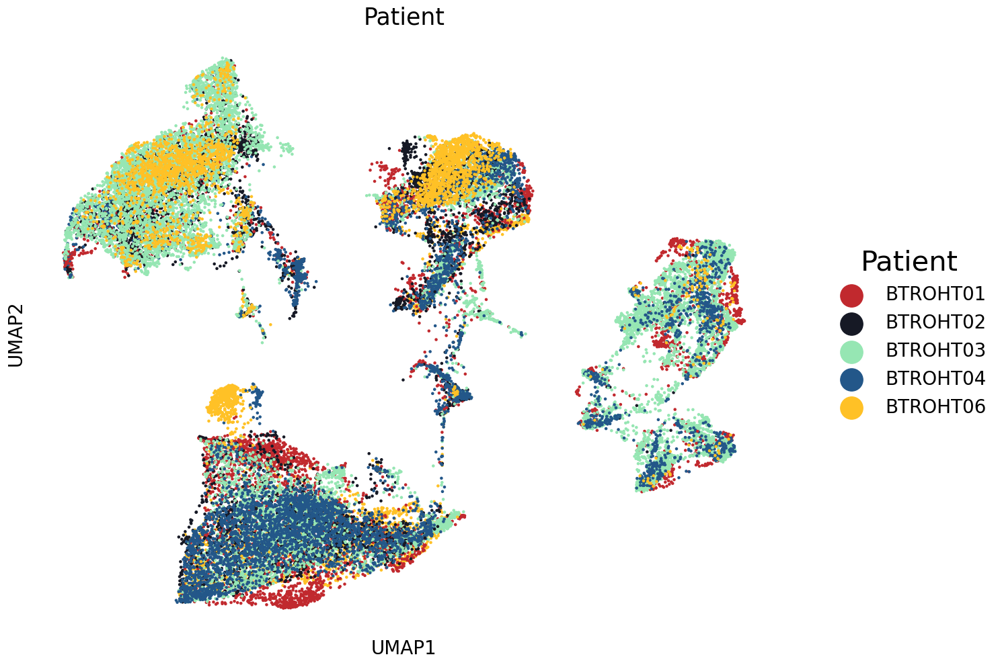

In [11]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

# Ensure the patient column is categorical
all_data.obs["patient"] = all_data.obs["patient"].astype("category")

# Apply custom patient colors
all_data.uns["patient_colors"] = [
    patient_colors[pt] for pt in all_data.obs["patient"].cat.categories
]

# Plot and capture figure
fig = sc.pl.umap(
    all_data,
    color='patient',
    size=43,
    frameon=True,
    return_fig=True,
    legend_loc='right margin'
)

# Resize figure
fig.set_size_inches(15, 10)

# Access Axes
ax = fig.axes[0]

# Set axis labels and title
ax.set_xlabel("UMAP1", fontsize=20)
ax.set_ylabel("UMAP2", fontsize=20)
ax.set_title("Patient", fontsize=25)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# ✅ Adjust legend font size & dot size
legend = ax.get_legend()
if legend is not None:
    # Increase font size
    for text in legend.get_texts():
        text.set_fontsize(10)

    # Increase marker (dot) size by re-setting the legend
    handles, labels = ax.get_legend_handles_labels()
    legend.remove()  # remove old legend
    ax.legend(
        handles,
        labels,
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=20,
        title="Patient",
        title_fontsize=30,
        markerscale=4,  # ✅ Increase dot size
        frameon=False
    )

plt.tight_layout()
plt.show()


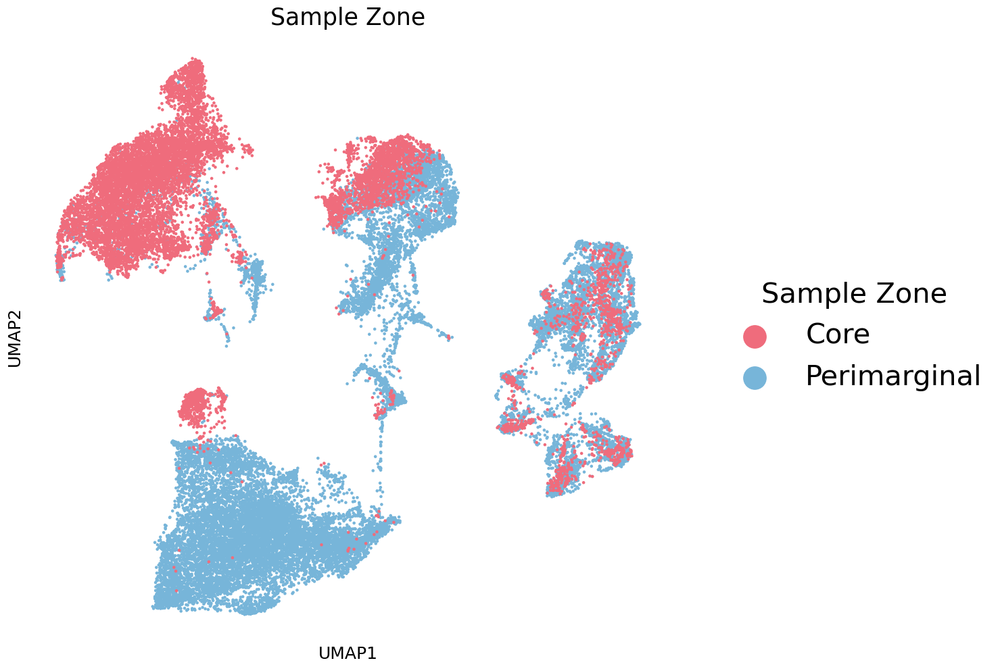

In [12]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

# Ensure the 'site' column is categorical
all_data.obs["site"] = all_data.obs["site"].astype("category")

# Define custom colors
site_colors = {
    "Core": "#ef6c7c",         # Coral Pink
    "Peri": "#77b5d9"          # Sharper Sky Blue
}

# Apply the colors in the correct order
all_data.uns["site_colors"] = [site_colors[cat] for cat in all_data.obs["site"].cat.categories]

# Plot and capture the figure
fig = sc.pl.umap(
    all_data,
    color='site',
    size=43,
    frameon=True,
    return_fig=True,
    legend_loc='right margin'
)

# Resize the figure
fig.set_size_inches(15, 10)

# Access the Axes object
ax = fig.axes[0]

# Set axis labels
ax.set_xlabel("UMAP1", fontsize=18)
ax.set_ylabel("UMAP2", fontsize=18)
ax.set_title("Sample Zone", fontsize=25)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Adjust legend
legend = ax.get_legend()
if legend is not None:
    # Update label names
    handles, labels = ax.get_legend_handles_labels()
    label_map = {"Peri": "Perimarginal", "Core": "Core"}
    labels = [label_map.get(label, label) for label in labels]

    legend.remove()
    ax.legend(
        handles,
        labels,
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=30,
        title="Sample Zone",
        title_fontsize=30,
        markerscale=4,
        frameon=False
    )

plt.tight_layout()
plt.show()


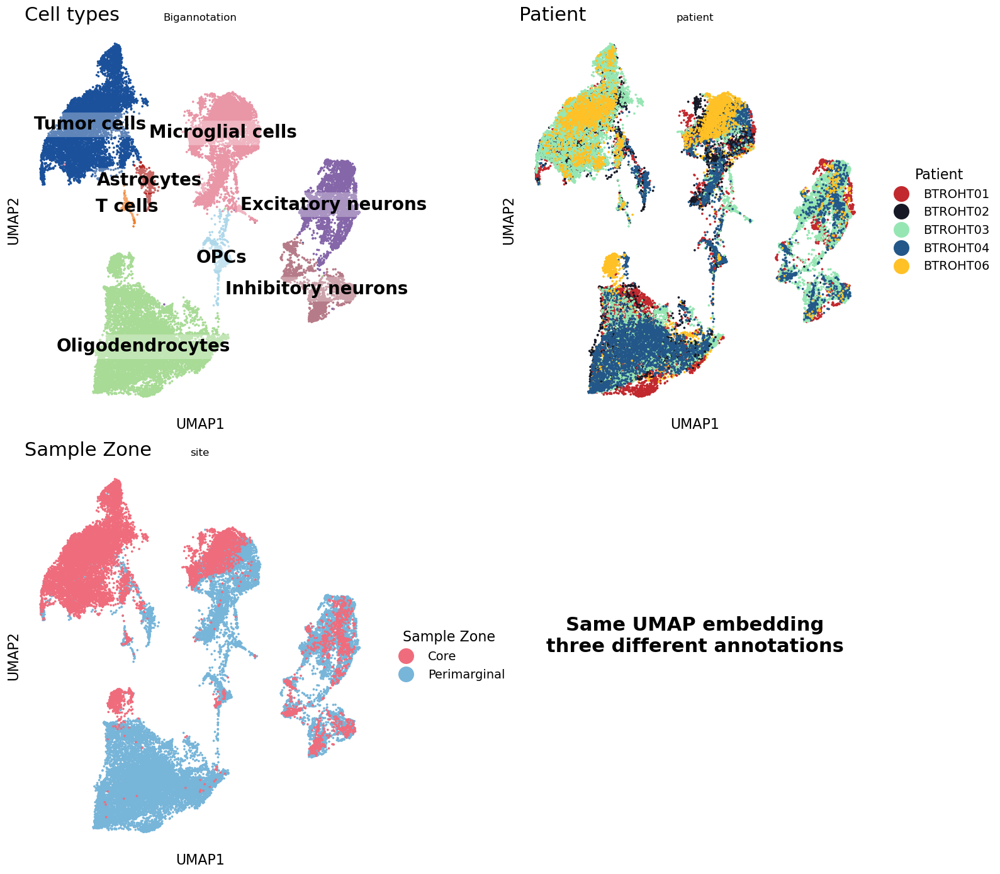

In [18]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.lines import Line2D

# -------- unified styling --------
POINT_SIZE   = 28
TITLE_SIZE   = 22
LABEL_SIZE   = 16
TICK_SIZE    = 12
LEGEND_SIZE  = 14
LEGEND_TITLE = 16
MARKERSCALE  = 3.0

def style_axis(ax, title=None):
    ax.set_xlabel("UMAP1", fontsize=LABEL_SIZE)
    ax.set_ylabel("UMAP2", fontsize=LABEL_SIZE)
    if title:
        ax.set_title(title, fontsize=TITLE_SIZE, pad=6, loc='left')  # ← title on left
    for s in ax.spines.values():
        s.set_visible(False)
    ax.tick_params(axis='both', which='major', labelsize=TICK_SIZE)


def add_categorical_legend(ax, cats, colors, *, title, rename_map=None):
    labels = [rename_map.get(c, c) if rename_map else c for c in cats]
    handles = [Line2D([0],[0], marker='o', linestyle='',
                      markerfacecolor=colors[i], markeredgecolor='none', markersize=6)
               for i in range(len(cats))]
    leg = ax.legend(handles, labels, loc='center left', bbox_to_anchor=(1.02, 0.5),
                    fontsize=LEGEND_SIZE, frameon=False, title=title, markerscale=MARKERSCALE)
    if leg.get_title(): leg.get_title().set_fontsize(LEGEND_TITLE)

# -------- ensure categories & colors --------
all_data.obs["Bigannotation"] = all_data.obs["Bigannotation"].astype("category")
all_data.obs["patient"]       = all_data.obs["patient"].astype("category")
all_data.obs["site"]          = all_data.obs["site"].astype("category")

all_data.uns["Bigannotation_colors"] = [
    cell_type_colors[ct] for ct in all_data.obs["Bigannotation"].cat.categories
]
all_data.uns["patient_colors"] = [
    patient_colors[pt] for pt in all_data.obs["patient"].cat.categories
]
site_colors = {"Core": "#ef6c7c", "Peri": "#77b5d9"}
all_data.uns["site_colors"] = [site_colors[s] for s in all_data.obs["site"].cat.categories]

# -------- figure: 2×2 --------
fig, axs = plt.subplots(2, 2, figsize=(16, 14))
ax00, ax01, ax10, ax11 = axs.ravel()

# (0,0) Bigannotation — no legend; in-plot labels
sc.pl.umap(all_data, color="Bigannotation", size=POINT_SIZE, frameon=True,
           ax=ax00, show=False, legend_loc=None)
style_axis(ax00, "Cell types")
umap_df = pd.DataFrame(all_data.obsm["X_umap"], columns=["UMAP1","UMAP2"])
umap_df["label"] = all_data.obs["Bigannotation"].values
for lab in umap_df["label"].unique():
    x = umap_df.loc[umap_df["label"] == lab, "UMAP1"].median()
    y = umap_df.loc[umap_df["label"] == lab, "UMAP2"].median()
    ax00.text(x, y, str(lab), fontsize=LABEL_SIZE+4, weight='bold',
              ha='center', va='center',
              bbox=dict(facecolor='white', alpha=0.3, edgecolor='none', boxstyle='round,pad=0.2'))

# (0,1) Patient — keep legend/colors
sc.pl.umap(all_data, color="patient", size=POINT_SIZE, frameon=True,
           ax=ax01, show=False, legend_loc=None)
style_axis(ax01, "Patient")
add_categorical_legend(
    ax01,
    list(all_data.obs["patient"].cat.categories),
    list(all_data.uns["patient_colors"]),
    title="Patient"
)

# (1,0) Site — keep legend/colors; rename Peri→Perimarginal in legend only
sc.pl.umap(all_data, color="site", size=POINT_SIZE, frameon=True,
           ax=ax10, show=False, legend_loc=None)
style_axis(ax10, "Sample Zone")
add_categorical_legend(
    ax10,
    list(all_data.obs["site"].cat.categories),
    list(all_data.uns["site_colors"]),
    title="Sample Zone",
    rename_map={"Peri": "Perimarginal", "Core": "Core"}
)

# (1,1) Info panel
ax11.axis('off')
ax11.text(
    0.5, 0.55,
    "Same UMAP embedding\nthree different annotations",
    ha="center", va="center", fontsize=TITLE_SIZE, weight="bold"
)
ax11.text(
    0.5, 0.30,
    "Top-left: Bigannotation (labels on map)\n"
    "Top-right: Patient (legend preserved)\n"
    "Bottom-left: Sample Zone (legend preserved)",
    ha="center", va="center", fontsize=LABEL_SIZE
)

plt.tight_layout()
# Optional: save
# plt.savefig("umap_2x2_three_plus_info.png", dpi=300, bbox_inches="tight")
plt.show()


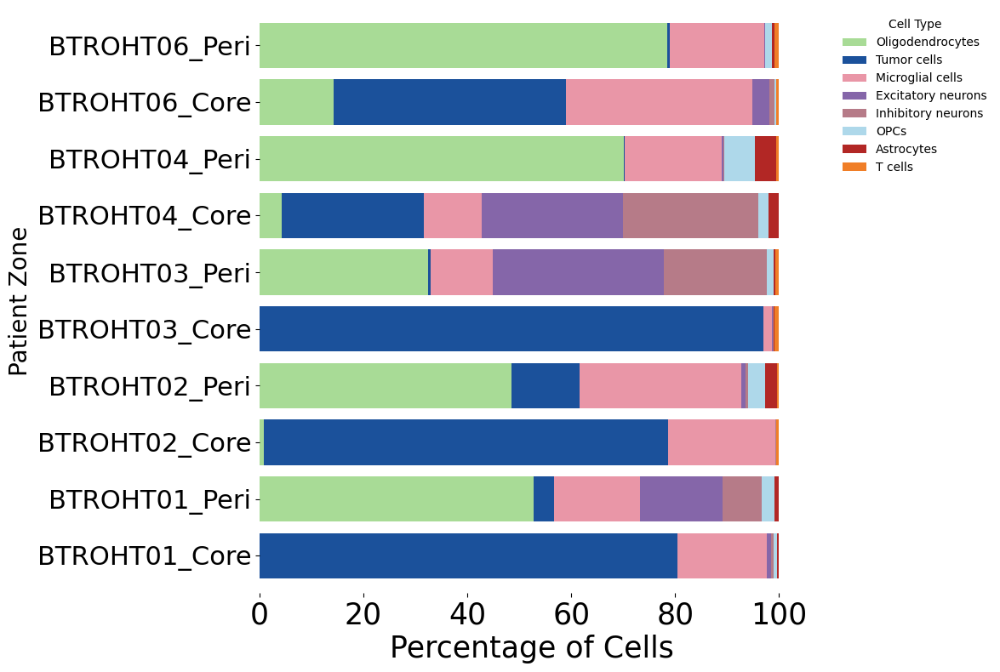

In [41]:
import pandas as pd
import matplotlib.pyplot as plt

# 1. Cross-tabulate counts of cell types per patient zone
count_df = pd.crosstab(all_data.obs["patientzone"], all_data.obs["Bigannotation"])

# 2. Normalize to get percentages
percent_df = count_df.div(count_df.sum(axis=1), axis=0) * 100

# 3. Reorder columns to match your custom color dict
percent_df = percent_df[[ct for ct in cell_type_colors.keys() if ct in percent_df.columns]]

# 4. Plot
ax = percent_df.plot(
    kind="barh",
    stacked=True,
    figsize=(12, 8),
    color=[cell_type_colors[ct] for ct in percent_df.columns],
    width=0.8
)

# Remove the box around the plot (spines)
for spine in ax.spines.values():
    spine.set_visible(False)

# Axis labels and ticks
ax.set_xlabel("Percentage of Cells", fontsize=25)
ax.set_ylabel("Patient Zone", fontsize=20)
plt.yticks(fontsize=22)
plt.xticks(fontsize=25)

# Legend
plt.legend(title="Cell Type", bbox_to_anchor=(1.05, 1), loc="upper left", frameon=False)

plt.tight_layout()
plt.show()


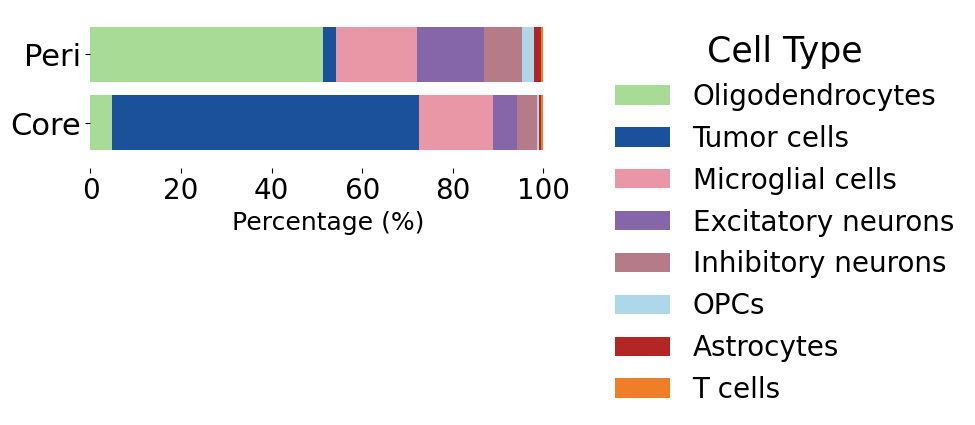

In [55]:
import pandas as pd
import matplotlib.pyplot as plt

# 1. Cross-tabulate counts of cell types per patient
count_df = pd.crosstab(all_data.obs["site"], all_data.obs["Bigannotation"])

# 2. Normalize to get percentages
percent_df = count_df.div(count_df.sum(axis=1), axis=0) * 100

# 3. Reorder columns to match your color palette
percent_df = percent_df[[ct for ct in cell_type_colors.keys() if ct in percent_df.columns]]

# 4. Plot
ax = percent_df.plot(
    kind="barh",
    stacked=True,
    figsize=(10, 3.35),
    color=[cell_type_colors[ct] for ct in percent_df.columns],
    width=0.8
)

# ✅ Remove the box (spines)
for spine in ax.spines.values():
    spine.set_visible(False)

# Axis styling
ax.set_xlabel("Percentage (%)", fontsize=18)
ax.set_ylabel("", fontsize=22)
plt.yticks(fontsize=22)
plt.xticks(fontsize=20)

# ✅ Customize legend (size, title, spacing)
legend = ax.legend(
    title="Cell Type",
    title_fontsize=25,      # legend title size
    fontsize=20,            # legend text size
    bbox_to_anchor=(1.05, 1),
    loc="upper left",
    frameon=False           # remove box around legend
)

# Clean layout
plt.tight_layout()
plt.show()


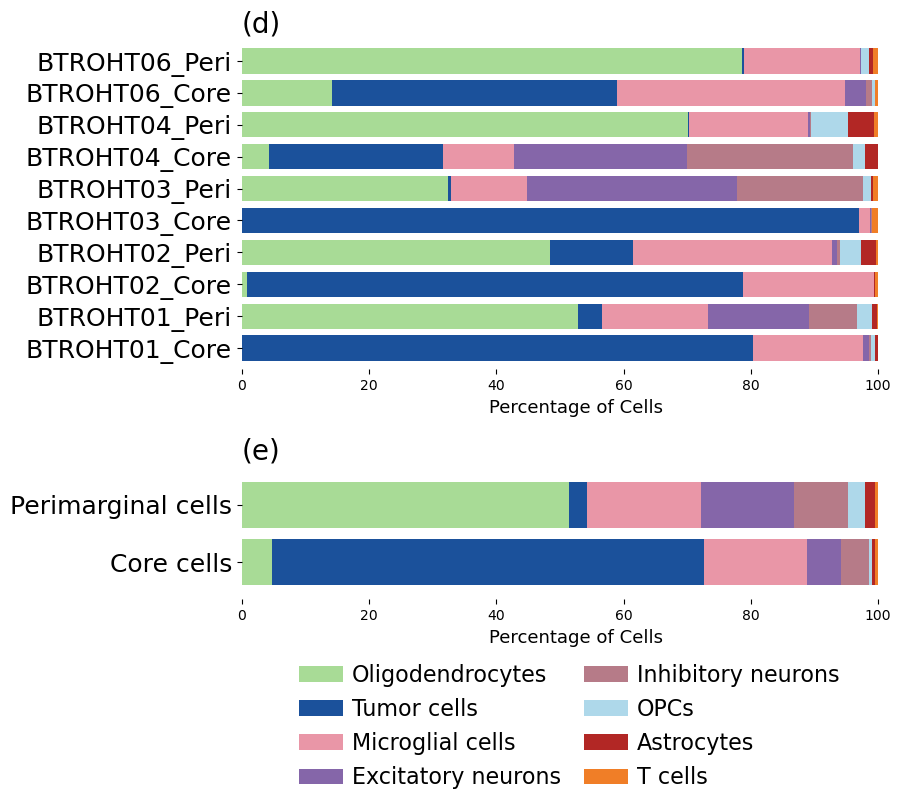

In [258]:
import pandas as pd
import matplotlib.pyplot as plt

# === 1️⃣ First plot: patientzone ===
count_df_zone = pd.crosstab(all_data.obs["patientzone"], all_data.obs["Bigannotation"])
percent_df_zone = count_df_zone.div(count_df_zone.sum(axis=1), axis=0) * 100
percent_df_zone = percent_df_zone[[ct for ct in cell_type_colors.keys() if ct in percent_df_zone.columns]]

# === 2️⃣ Second plot: site ===
count_df_site = pd.crosstab(all_data.obs["site"], all_data.obs["Bigannotation"])
percent_df_site = count_df_site.div(count_df_site.sum(axis=1), axis=0) * 100
percent_df_site = percent_df_site[[ct for ct in cell_type_colors.keys() if ct in percent_df_site.columns]]
percent_df_site = percent_df_site.rename(index={
    "Peri": "Perimarginal cells",
    "Core": "Core cells"
})

# === Figure (for 2×2 subplot bottom-right size proportions) ===
fig, (ax1, ax2) = plt.subplots(
    2, 1, figsize=(9.3, 8.3),  # small size for embedding
    gridspec_kw={'height_ratios': [2.5, 1]}  # balance space visually
)

# --- Plot (d): patient zone ---
percent_df_zone.plot(
    kind="barh",
    stacked=True,
    ax=ax1,
    color=[cell_type_colors[ct] for ct in percent_df_zone.columns],
    width=0.8
)
for spine in ax1.spines.values():
    spine.set_visible(False)
ax1.set_xlabel("Percentage of Cells", fontsize=13)
ax1.set_ylabel("", fontsize=6)
ax1.tick_params(axis='y', labelsize=18)
ax1.tick_params(axis='x', labelsize=10)
if ax1.get_legend() is not None:
    ax1.get_legend().remove()
ax1.set_title("(d)", loc="left", fontsize=20)
# --- Plot (e): site (with legend UNDER the plot) ---
percent_df_site.plot(
    kind="barh",
    stacked=True,
    ax=ax2,
    color=[cell_type_colors[ct] for ct in percent_df_site.columns],
    width=0.8
)
for spine in ax2.spines.values():
    spine.set_visible(False)

ax2.set_xlabel("Percentage of Cells", fontsize=13)
ax2.set_ylabel("", fontsize=6)
ax2.tick_params(axis='y', labelsize=18)
ax2.tick_params(axis='x', labelsize=10)
ax2.set_title("(e)", loc="left", fontsize=20)

# ✅ Legend BELOW the plot
handles, labels = ax2.get_legend_handles_labels()
legend = ax2.legend(
    handles,
    labels,
    title="",
    title_fontsize=14,
    fontsize=16,
    loc="upper center",
    bbox_to_anchor=(0.49, -0.34),  # ⬅️ Move legend below the plot
    ncol=2,                       # 2 columns
    frameon=False,
    labelspacing=0.5,
    columnspacing=1.0,
    handletextpad=0.4
)

plt.tight_layout(h_pad=1.5)
plt.show()


# TUMOR 

In [147]:
tumor= sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_row_FINAL_afteratac8121.h5ad")

In [148]:
tumor 

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source'

In [11]:
adata = tumor

In [12]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.02, max_mean=4, min_disp=0.5)
sc.pp.scale(adata)
sc.tl.pca(adata, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=25, )
sc.tl.leiden(adata, resolution=1.5, random_state=11)
sc.tl.umap(adata, random_state=11)

/home/fatemeh.nasrabadi/anaconda3/envs/new_scenv/lib/python3.11/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
/tmp/ipykernel_591568/3412052750.py:7: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=1.5, random_state=11)


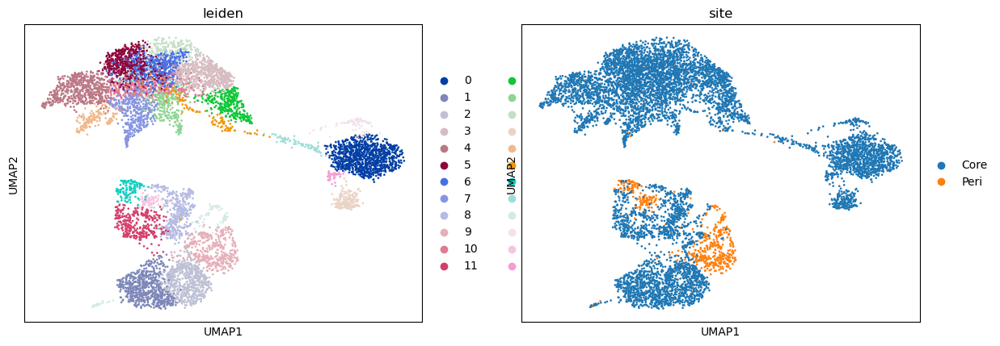

In [13]:
sc.pl.umap(adata, color=['leiden',"site"], vmax='p80')

In [22]:
import scanpy as sc

# --- you already ran preprocessing + PCA above ---

# 1) Harmony integrate on the PCA space (batch = "patient")
#    Writes the corrected PCs to: adata.obsm["X_pca_harmony"]
sc.external.pp.harmony_integrate(adata, key="patient")

# 2) Build graph on Harmony PCs
#    (use_rep tells neighbors to use the corrected embedding)
sc.pp.neighbors(
    adata,
    n_neighbors=15,
    use_rep="X_pca_harmony"   # <- important
)

# 3) UMAP on Harmony graph
sc.tl.umap(adata, random_state=11)

# 4) (Optional) Re-run clustering on Harmony graph (recommended)
sc.tl.leiden(adata, resolution=1.5, random_state=11)


2025-10-19 19:50:48,044 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-10-19 19:50:50,381 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-10-19 19:50:50,462 - harmonypy - INFO - Iteration 1 of 10
2025-10-19 19:50:51,892 - harmonypy - INFO - Iteration 2 of 10
2025-10-19 19:50:53,292 - harmonypy - INFO - Converged after 2 iterations


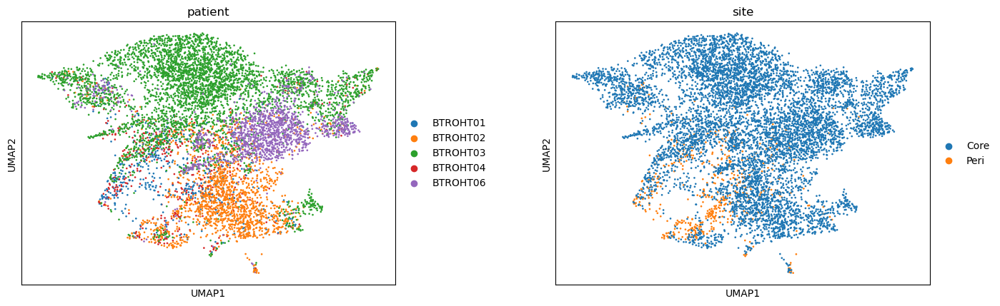

In [23]:
# 5) Plot UMAP using Harmony result
sc.pl.umap(
    adata,
    color=["patient", "site"],   # add other annotations if you like
    wspace=0.3,
    frameon=True
)


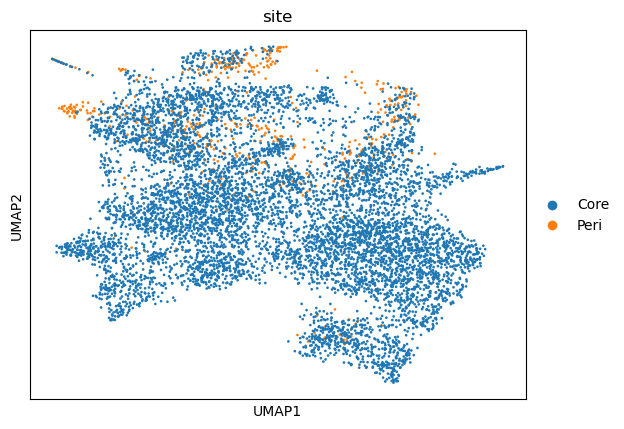

In [153]:
sc.pl.umap(
    adata,
    color=["site"],   # add other annotations if you like
    wspace=0.3,
    frameon=True
)


In [154]:
adata.write("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

In [155]:
tumor = sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

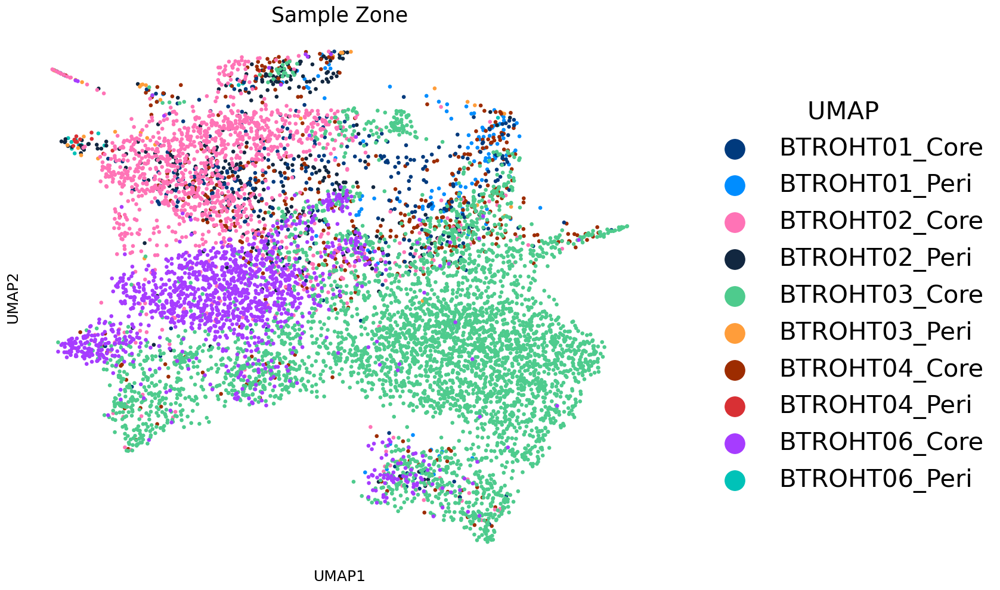

In [156]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

import seaborn as sns


# ساخت ستون ترکیبی patient_zone
tumor.obs["patient_zone"] = tumor.obs["patient"].astype(str) + "_" + tumor.obs["site"].astype(str)

# تبدیل به categorical با ترتیب مشخص
tumor.obs["patient_zone"] = pd.Categorical(
    tumor.obs["patient_zone"],
    categories=list(patient_zone_colors.keys()),
    ordered=True
)

# ثبت رنگ‌ها برای patient_zone
tumor.uns["patient_zone_colors"] = [patient_zone_colors[pz] for pz in tumor.obs["patient_zone"].cat.categories]

# ایجاد شکل
fig, ax = plt.subplots(figsize=(17, 7))

# پلات UMAP
sc.pl.umap(
    tumor,
    color='patient_zone',
    size=90,
    ax=ax,
    show=False,
    frameon=True
)


# Resize the figure
fig.set_size_inches(17,10)

# Access the Axes object
ax = fig.axes[0]

# Set axis labels
ax.set_xlabel("UMAP1", fontsize=18)
ax.set_ylabel("UMAP2", fontsize=18)
ax.set_title("Sample Zone", fontsize=25)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Adjust legend
legend = ax.get_legend()
if legend is not None:
    # Update label names
    handles, labels = ax.get_legend_handles_labels()
    label_map = {"Peri": "Perimarginal", "Core": "Core"}
    labels = [label_map.get(label, label) for label in labels]

    legend.remove()
    ax.legend(
        handles,
        labels,
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=30,
        title="UMAP ",
        title_fontsize=30,
        markerscale=4,
        frameon=False
    )

plt.tight_layout()
plt.show()


In [177]:
all_data

AnnData object with n_obs × n_vars = 32313 × 36601
    obs: 'site', 'patient', 'patientzone', 'source', 'leiden', 'celltype', 'cell_typist_majority_voting_Adult_Human_PrefrontalCortex', 'cell_typist_predicted_labels_Adult_Human_PrefrontalCortex', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'celltypist_conf_score_Adult_Human_PrefrontalCortex', 'final_celltype', 'Bigannotation', 'broad_celltype', 'edited_ann', 'Bigannotation_endo_macro', 'Bigannotation_neuron_detail', 'FINAL_ANNOTATION', 'OPCs', 'kmeans_cluster', 'Tumor_finalized_annotation'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Bigannotation_colors', 'Bigannotation_neuron_detail_colors', 'FINAL_ANNOTATION_colors', 'broad_celltype_colors', 'cell_typist_majority_voting_Adult_Human_PrefrontalCortex_colors', 'cell_typist_predicted_labels_Adult_Human_PrefrontalCortex_colors', 'celltype_colors', 'dendrogram_Bigannotation', 'edited_ann_colors', 'final_celltyp

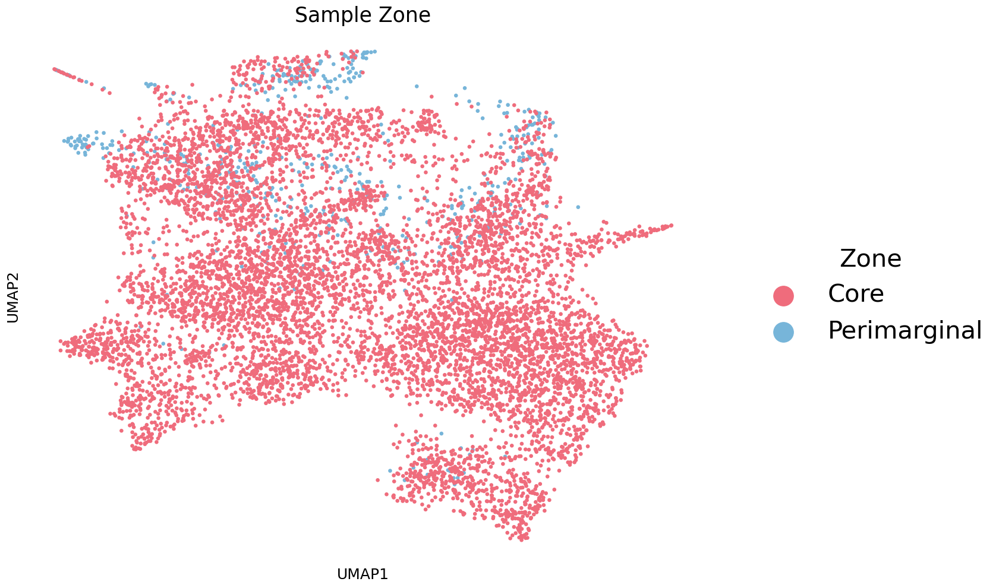

In [157]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

# Ensure the 'site' column is categorical
tumor.obs["site"] = tumor.obs["site"].astype("category")

# Define custom colors
site_colors = {
    "Core": "#ef6c7c",         # Coral Pink
    "Peri": "#77b5d9"          # Sharper Sky Blue
}

# Apply the colors in the correct order
tumor.uns["site_colors"] = [site_colors[cat] for cat in tumor.obs["site"].cat.categories]

# Plot and capture the figure
fig = sc.pl.umap(
    tumor,
    color='site',
    size=90,
    frameon=True,
    return_fig=True,
    legend_loc='right margin'
)

# Resize the figure
fig.set_size_inches(17, 10)

# Access the Axes object
ax = fig.axes[0]

# Set axis labels
ax.set_xlabel("UMAP1", fontsize=18)
ax.set_ylabel("UMAP2", fontsize=18)
ax.set_title("Sample Zone", fontsize=25)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Adjust legend
legend = ax.get_legend()
if legend is not None:
    # Update label names
    handles, labels = ax.get_legend_handles_labels()
    label_map = {"Peri": "Perimarginal", "Core": "Core"}
    labels = [label_map.get(label, label) for label in labels]

    legend.remove()
    ax.legend(
        handles,
        labels,
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=30,
        title="Zone",
        title_fontsize=30,
        markerscale=4,
        frameon=False
    )

plt.tight_layout()
plt.show()


In [224]:
all_data = all_data2

In [222]:
all_data = tumor

/tmp/ipykernel_475108/2226196632.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts_patient = tumor.obs.groupby(["patient", "site"]).size().unstack(fill_value=0)
/tmp/ipykernel_475108/2226196632.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts_site = tumor.obs.groupby(["site", "patient"]).size().unstack(fill_value=0)


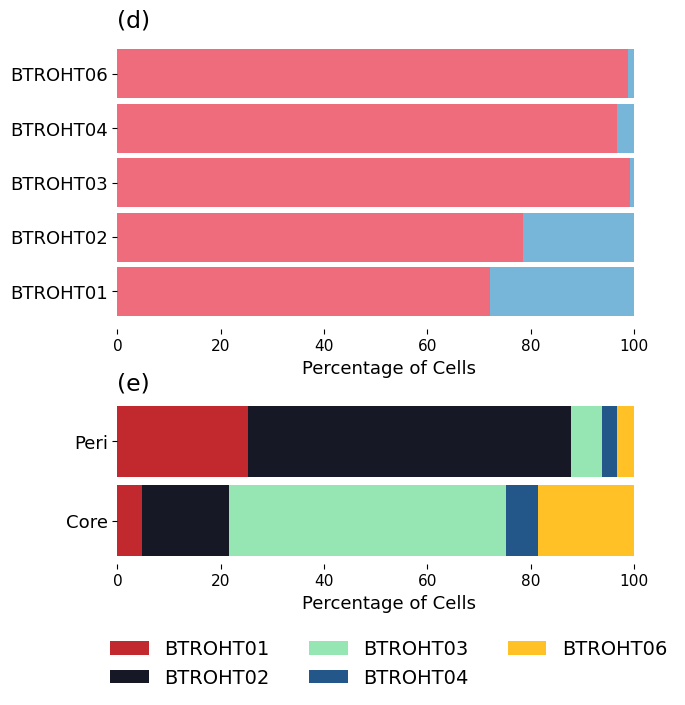

In [266]:
import pandas as pd
import matplotlib.pyplot as plt

# ==================  FIRST PLOT  ==================
counts_patient = tumor.obs.groupby(["patient", "site"]).size().unstack(fill_value=0)
percent_patient = counts_patient.div(counts_patient.sum(axis=1), axis=0) * 100
site_colors = {"Core": "#ef6c7c", "Peri": "#77b5d9"}
colors_site = [site_colors[s] for s in percent_patient.columns]

# ==================  SECOND PLOT  ==================
counts_site = tumor.obs.groupby(["site", "patient"]).size().unstack(fill_value=0)
percent_site = counts_site.div(counts_site.sum(axis=1), axis=0) * 100
colors_patients = [patient_colors[p] for p in percent_site.columns]

# ==================  COMBINED FIGURE ==================
fig, (ax1, ax2) = plt.subplots(
    2, 1,
    figsize=(7 , 8),
    gridspec_kw={'height_ratios': [2.3, 1.3]}
)

# ---------- (d) by Patient ----------
bottom = [0] * len(percent_patient)
for i, col in enumerate(percent_patient.columns):
    ax1.barh(
        y=percent_patient.index,
        width=percent_patient[col],
        left=bottom,
        color=colors_site[i],
        label=col,
        height=0.9
    )
    bottom = [x + y for x, y in zip(bottom, percent_patient[col])]

for s in ax1.spines.values(): s.set_visible(False)
ax1.set_xlabel("Percentage of Cells", fontsize=13)
ax1.set_ylabel("", fontsize=13)
ax1.set_title("(d)", loc="left", fontsize=17)
ax1.tick_params(axis='y', labelsize=13)
ax1.tick_params(axis='x', labelsize=11)

# Legend just under (d)
leg1 = ax1.legend(
    percent_patient.columns, title="",
    title_fontsize=12, fontsize=11,
    loc='upper center', bbox_to_anchor=(0.7, -0.60),  # was -0.35 → closer
    ncol=2, frameon=False
)

# ---------- (e) by Site ----------
bottom = [0] * len(percent_site)
for i, col in enumerate(percent_site.columns):
    ax2.barh(
        y=percent_site.index,
        width=percent_site[col],
        left=bottom,
        color=colors_patients[i],
        label=col,
        height=0.9
    )
    bottom = [x + y for x, y in zip(bottom, percent_site[col])]

for s in ax2.spines.values(): s.set_visible(False)
ax2.set_xlabel("Percentage of Cells", fontsize=13)
ax2.set_ylabel("", fontsize=13)
ax2.set_title("(e)", loc="left", fontsize=17)
ax2.tick_params(axis='y', labelsize=13)
ax2.tick_params(axis='x', labelsize=11)

# Legend under (e), but not overlapping
leg2 = ax2.legend(
    percent_site.columns, title="",
    title_fontsize=12, fontsize=14,
    loc='upper center', bbox_to_anchor=(0.5, -0.35),  # gentler offset
    ncol=3, frameon=False
)

# ---- spacing tweaks ----
fig.subplots_adjust(hspace=0.3, bottom=0.22)  # closer rows; reserve space for bottom legend
plt.show()


In [184]:
all_data = all_data2

In [185]:
tumor

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source', 'leiden', 'patient_zone', 'S_score', 'G2M_score', 'phase'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'patient_colors', 'pca', 'site_colors', 'umap', 'patient_zone_colors', 'phase_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

# cell cycle analysis 

In [3]:
tumor = sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

In [5]:
tumor

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source', 'leiden', 'patient_zone', 'S_score', 'G2M_score', 'phase'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'patient_colors', 'patient_zone_colors', 'pca', 'phase_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [9]:
tumor = sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_row_FINAL_afteratac8121.h5ad")

In [10]:
tumor

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source'

In [12]:
import scanpy as sc

# Make a copy if you want to keep original raw data
tumor = tumor_raw.copy()

# 1) Normalize each cell to 10,000 counts
sc.pp.normalize_total(tumor, target_sum=1e4)

# 2) Log-transform the normalized data
sc.pp.log1p(tumor)


In [13]:
s_genes = [
    'MCM5', 'PCNA', 'TYMS', 'FEN1', 'MCM2', 'MCM4', 'RRM1', 'UNG', 'GINS2',
    'MCM6', 'CDCA7', 'DTL', 'PRIM1', 'UHRF1', 'MLF1IP', 'HELLS', 'RFC2', 'RPA2',
    'NASP', 'RAD51AP1', 'GMNN', 'WDR76', 'SLBP', 'CCNE2', 'UBR7', 'POLD3',
    'MSH2', 'ATAD2', 'RAD51', 'RRM2', 'CDC45', 'CDC6', 'EXO1', 'TIPIN', 'DSCC1',
    'BLM', 'CASP8AP2', 'USP1', 'CLSPN', 'POLA1', 'CHAF1B', 'BRIP1'
]



g2m_genes = [
    'E2F8', 'HMGB2', 'CDK1', 'NUSAP1', 'UBE2C', 'BIRC5', 'TPX2', 'TOP2A',
    'NDC80', 'CKS2', 'NUF2', 'CKS1B', 'MKI67', 'TMPO', 'CENPF', 'TACC3',
    'FAM64A', 'SMC4', 'CCNB2', 'CKAP2L', 'CKAP2', 'AURKB', 'BUB1', 'KIF11',
    'ANP32E', 'TUBB4B', 'GTSE1', 'KIF20B', 'HJURP', 'CDCA3', 'HN1', 'CDC20',
    'TTK', 'CDC25C', 'KIF2C', 'RANGAP1', 'NCAPD2', 'DLGAP5', 'CDCA2', 'CDCA8',
    'ECT2', 'KIF23', 'HMMR', 'AURKA', 'PSRC1', 'ANLN', 'LBR', 'CKAP5', 'CENPE',
    'CTCF', 'NEK2', 'G2E3', 'GAS2L3', 'CBX5', 'CENPA'
]


In [14]:
sc.tl.score_genes_cell_cycle(tumor, s_genes=s_genes, g2m_genes=g2m_genes)

/tmp/ipykernel_3763332/2249163547.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_3763332/2249163547.py:55: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(
/tmp/ipykernel_3763332/2249163547.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_3763332/2249163547.py:55: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(
/tmp/ipykernel_3763332/2249163547.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will b

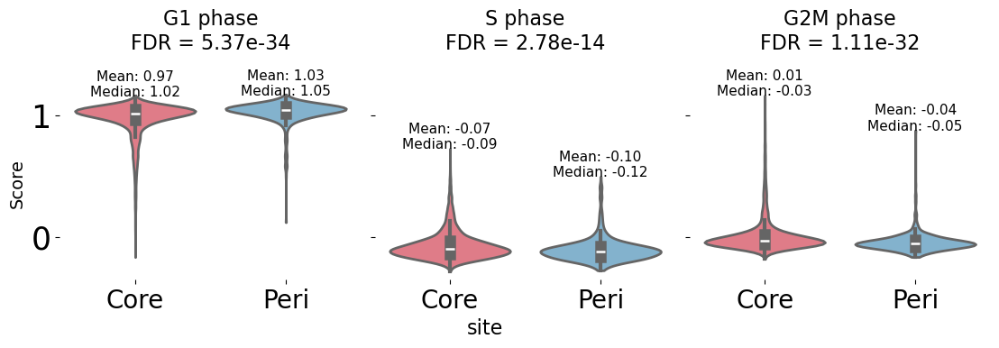

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests

# ----- build long-form with G1 from S/G2M -----
df = tumor.obs[['site', 'S_score', 'G2M_score']].copy()
df['G1_score'] = 1 - df[['S_score', 'G2M_score']].max(axis=1)

long = df.melt(
    id_vars='site',
    value_vars=['G1_score', 'S_score', 'G2M_score'],
    var_name='Phase', value_name='Score'
)

phase_order  = ['G1_score', 'S_score', 'G2M_score']

phase_pretty = {'G1_score': 'G1 phase', 'S_score': 'S phase', 'G2M_score': 'G2M phase'}

site_order   = ['Core', 'Peri']
site_palette = {'Core': '#ef6c7c', 'Peri': '#77b5d9'}

# ===========================
#    1) Compute raw p-values
# ===========================
raw_pvals = []

for phase in phase_order:
    data = long[long['Phase'] == phase]
    d_core = data[data['site'] == 'Core']['Score'].dropna()
    d_peri = data[data['site'] == 'Peri']['Score'].dropna()
    stat, p = mannwhitneyu(d_core, d_peri, alternative='two-sided')
    raw_pvals.append(p)

# =========================================
#    2) Apply multiple-comparison correction
# =========================================
rej, corrected_pvals, _, _ = multipletests(raw_pvals, method='fdr_bh')

# pack into dict for easy access
phase_to_corr_p = dict(zip(phase_order, corrected_pvals))
phase_to_signif = dict(zip(phase_order, rej))

# ===========================
#    3) Plot
# ===========================
fig, axes = plt.subplots(1, 3, figsize=(12, 4), sharey=True)

for i, phase in enumerate(phase_order):
    ax = axes[i]
    data = long[long['Phase'] == phase]

    sns.violinplot(
        data=data, x='site', y='Score',
        order=site_order,
        palette=[site_palette[s] for s in site_order],
        inner='box', linewidth=2, cut=0, scale='width',
        ax=ax
    )

    # ---- means/medians ----
    for j, s in enumerate(site_order):
        vals = data.loc[data['site'] == s, 'Score']
        ax.text(j, vals.max(), f"Mean: {vals.mean():.2f}\nMedian: {vals.median():.2f}",
                ha='center', fontsize=11)

    # ---- corrected p-value ----
    corr_p = phase_to_corr_p[phase]
    signif = phase_to_signif[phase]

    sig_label = "Significant" if signif else "Not significant"

    ax.set_title(
    f"{phase_pretty[phase]}\nFDR = {corr_p:.2e}",
    fontsize=16,
    pad=30,
    loc='center'
)

    # labels / cosmetics
    ax.set_xlabel("")
    if i == 0:
        ax.set_ylabel("Score", fontsize=18)
    else:
        ax.set_ylabel("")

# Increase Core and Peri label size
    ax.tick_params(axis='x', labelsize=20)
    ax.tick_params(axis='y', labelsize=25)



    ax.set_xlabel("")
    if i == 0:
        ax.set_ylabel("Score", fontsize=14)
    else:
        ax.set_ylabel("")
    for s in ax.spines.values():
        s.set_visible(False)

fig.text(0.5, 0.02, "site", ha="center", fontsize=16)
plt.tight_layout(rect=[0.02, 0.04, 0.98, 0.96])
plt.show()


In [162]:
phase_palette = {
    'S_score': '#298c8c',     # Teal
    'G2M_score': '#a00000',   # Red
    'G1_score': '#b8b8b8'     # Gray
}


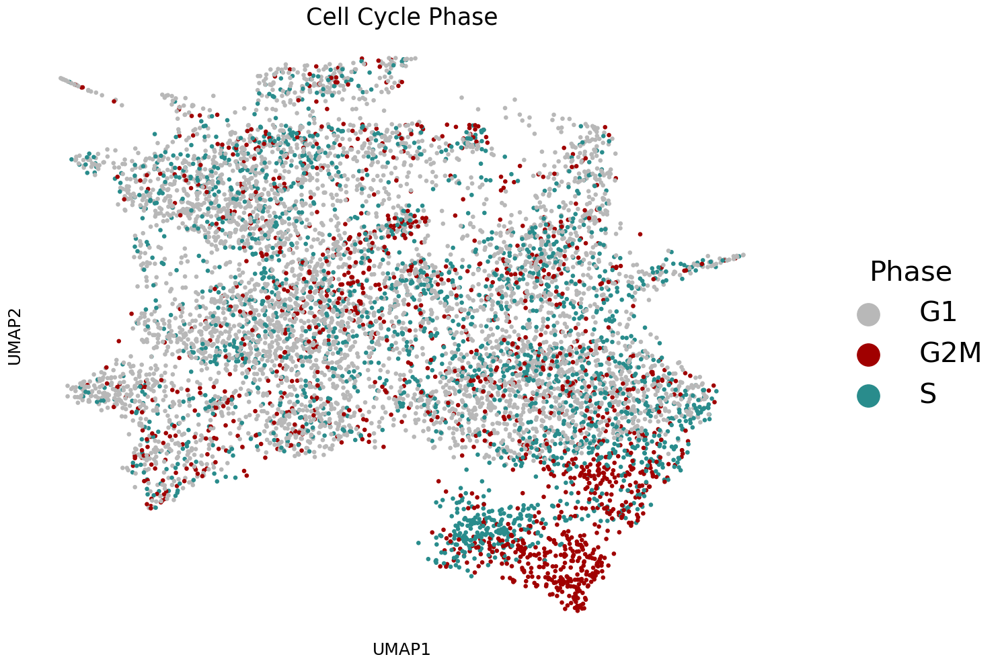

In [34]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

# Ensure 'phase' is categorical
tumor.obs["phase"] = tumor.obs["phase"].astype("category")

# Define custom colors
phase_palette = {
    'S': '#298c8c',     # Teal
    'G2M': '#a00000',   # Red
    'G1': '#b8b8b8'     # Gray
}

# Apply the colors in the correct order
tumor.uns["phase_colors"] = [phase_palette[cat] for cat in tumor.obs["phase"].cat.categories]

# Plot and capture the figure
fig = sc.pl.umap(
    tumor,
    color='phase',
    size=90,
    frameon=True,
    return_fig=True,
    legend_loc='right margin'
)

# Resize the figure
fig.set_size_inches(15, 10)

# Access the Axes object
ax = fig.axes[0]

# Set axis labels and title
ax.set_xlabel("UMAP1", fontsize=18)
ax.set_ylabel("UMAP2", fontsize=18)
ax.set_title("Cell Cycle Phase", fontsize=25)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Adjust legend
legend = ax.get_legend()
if legend is not None:
    # Update label names if needed
    handles, labels = ax.get_legend_handles_labels()
    label_map = {
        "S_score": "S phase",
        "G2M_score": "G2/M phase",
        "G1_score": "G1 phase"
    }
    labels = [label_map.get(label, label) for label in labels]

    legend.remove()
    ax.legend(
        handles,
        labels,
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=30,
        title="Phase",
        title_fontsize=30,
        markerscale=4,
        frameon=False
    )

plt.tight_layout()
plt.show()


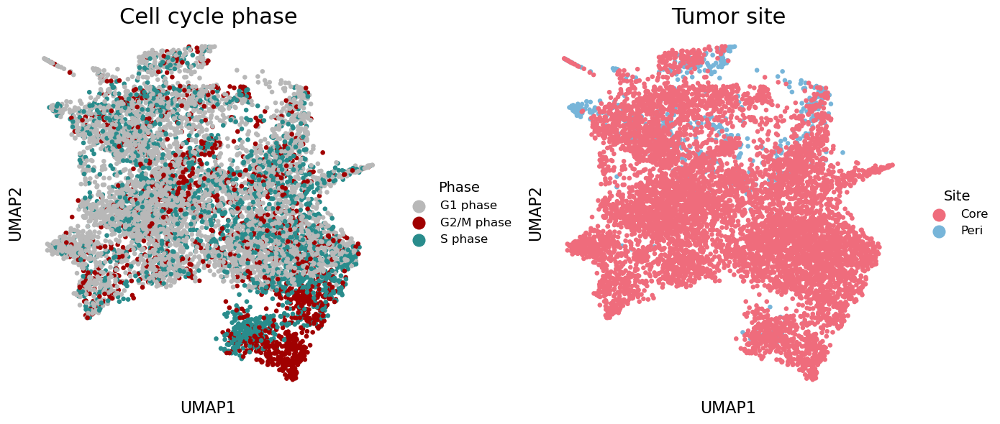

In [37]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

# --- categories & colors ---
tumor.obs["phase"] = tumor.obs["phase"].astype("category")
tumor.obs["site"]  = tumor.obs["site"].astype("category")

phase_palette = {
    'S':   '#298c8c',   # Teal
    'G2M': '#a00000',   # Red
    'G1':  '#b8b8b8'    # Gray
}
site_palette = {
    'Core': '#ef6c7c',
    'Peri': '#77b5d9'
}

tumor.uns["phase_colors"] = [phase_palette[c] for c in tumor.obs["phase"].cat.categories]
tumor.uns["site_colors"]  = [site_palette[c]  for c in tumor.obs["site"].cat.categories]

# --- make 2-panel figure ---
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# ========== LEFT: phase ==========
sc.pl.umap(
    tumor,
    color='phase',
    size=90,
    frameon=True,
    ax=axes[0],
    show=False,
    legend_loc='right margin'
)

ax0 = axes[0]
ax0.set_xlabel("UMAP1", fontsize=16)
ax0.set_ylabel("UMAP2", fontsize=16)
ax0.set_title("Cell cycle phase", fontsize=22)

for spine in ax0.spines.values():
    spine.set_visible(False)

# legend: rename S/G2M/G1 nicely
leg0 = ax0.get_legend()
if leg0 is not None:
    handles, labels = ax0.get_legend_handles_labels()
    label_map = {'S': 'S phase', 'G2M': 'G2/M phase', 'G1': 'G1 phase'}
    labels = [label_map.get(l, l) for l in labels]

    leg0.remove()
    ax0.legend(
        handles,
        labels,
        loc='center left',
        bbox_to_anchor=(1.02, 0.5),
        fontsize=12,
        title="Phase",
        title_fontsize=14,
        markerscale=2,
        frameon=False
    )

# ========== RIGHT: site ==========
sc.pl.umap(
    tumor,
    color='site',
    size=90,
    frameon=True,
    ax=axes[1],
    show=False,
    legend_loc='right margin'
)

ax1 = axes[1]
ax1.set_xlabel("UMAP1", fontsize=16)
ax1.set_ylabel("UMAP2", fontsize=16)
ax1.set_title("Tumor site", fontsize=22)

for spine in ax1.spines.values():
    spine.set_visible(False)

leg1 = ax1.get_legend()
if leg1 is not None:
    handles, labels = ax1.get_legend_handles_labels()
    leg1.remove()
    ax1.legend(
        handles,
        labels,
        loc='center left',
        bbox_to_anchor=(1.02, 0.5),
        fontsize=12,
        title="Site",
        title_fontsize=14,
        markerscale=2,
        frameon=False
    )

plt.tight_layout()
plt.show()


In [33]:
tumor = sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

In [165]:
tumor.write("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

In [ ]:
## check gene expresseion

In [4]:
tumor = sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_row_FINAL_afteratac8121.h5ad")

In [5]:
sc.pp.normalize_total(tumor, target_sum=1e4)
sc.pp.log1p(tumor)

In [ ]:
nes = tumor

# Check the signatures 

In [11]:
tumor =  sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

In [12]:
gene_list_AC = [
    "AC", "CST3", "S100B", "SLC1A3", "HEPN1", "HOPX", "MT3", "SPARCL1",
    "MLC1", "GFAP", "FABP7", "BCAN", "PON2", "METTL7B", "SPARC", "GATM",
    "RAMP1", "PMP2", "AQP4", "DBI", "EDNRB", "PTPRZ1", "CLU", "PMP22",
    "ATP1A2", "S100A16", "HEY1", "PCDHGC3", "TTYH1", "NDRG2", "PRCP",
    "ATP1B2", "AGT", "PLTP", "GPM6B", "F3", "RAB31", "PPAP2B", "ANXA5", "TSPAN7"
]


In [13]:
#Mes like
gene_list_mes = [
 "HILPDA", "CHI3L1", "ADM", "ANXA2", "DDIT3", "ANXA1",
    "NDRG1", "CD44", "HERPUD1", "VIM", "DNAJB9", "MT2A", "TRIB3", "C1S",
    "ENO2", "NAMPT", "AKAP12", "EFEMP1", "SQSTM1", "C1R", "MT1X", "SOD2",
    "ATF3", "IFITM3", "NAMPT", "TIMP1", "NRN1", "SPP1", "SLC2A1", "A2M",
    "BNIP3", "S100A11", "LGALS3", "MT1X", "INSIG2", "S100A10", "IGFBP3", "FN1",
    "PPP1R15A", "LGALS1", "VIM", "S100A16", "PLOD2", "CLIC1", "GBE1", "MGST1",
    "SLC2A3", "RCAN1", "FTL", "TAGLN2", "WARS", "NPC2", "ERO1L", "SERPING1",
    "XPOT", "C8orf4", "HSPA5", "EMP1", "GDF15", "APOE", "ANXA2", "CTSB",
    "EPAS1", "C3", "LDHA", "LGALS3", "P4HA1", "MT1E", "SERTAD1", "EMP3",
    "PFKP", "SERPINA3", "PGK1", "ACTN1", "EGLN3", "PRDX6", "SLC6A6", "IGFBP7",
    "CA9", "SERPINE1", "BNIP3L", "PLP2", "RPL21", "MGP", "TRAM1", "CLIC4",
    "UFM1", "GFPT2", "ASNS", "GSN", "GOLT1B", "NNMT", "ANGPTL4", "TUBA1C",
    "SLC39A14", "GJA1", "CDKN1A", "TNFRSF1A", "HSPA9", "WWTR1"
]


In [14]:
gene_list_OPC = [
   "BCAN", "PLP1", "GPR17", "FIBIN", "LHFPL3", "OLIG1", "PSAT1", "SCRG1",
    "OMG", "APOD", "SIRT2", "TNR", "THY1", "PHYHIPL", "SOX2-OT", "NKAIN4", "LPPR1",
    "PTPRZ1", "VCAN", "DBI", "PMP2", "CNP", "TNS3", "LIMA1", "CA10", "PCDHGC3",
    "CNTN1", "SCD5", "P2RX7", "CADM2", "TTYH1", "FGF12", "TMEM206", "NEU4", "FXYD6",
    "RNF13", "RTKN", "GPM6B", "LMF1", "ALCAM", "PGRMC1", "HRASLS", "BCAS1", "RAB31",
    "PLLP", "FABP5", "NLGN3", "SERINC5", "EPB41L2", "GPR37L1"
]


In [15]:
gene_list_NPC = [
    "DLL3", "STMN2", "DLL1", "CD24", "SOX4", "RND3", "TUBB3", "HMP19",
    "HES6", "TUBB3", "TAGLN3", "MIAT", "NEU4", "DCX", "MARCKSL1", "NSG1", "CD24", "ELAVL4",
    "STMN1", "MLLT11", "TCF12", "DLX6-AS1", "BEX1", "SOX11", "OLIG1", "NREP", "MAP2", "FNBP1L",
    "FXYD6", "TAGLN3", "PTPRS", "STMN4", "MLLT11", "DLX5", "NPPA", "SOX4", "BCAN", "MAP1B",
    "MEST", "RBFOX2", "ASCL1", "IGFBPL1", "BTG2", "STMN1", "DCX", "HN1", "NXPH1", "TMEM161B-AS1",
    "HN1", "DPYSL3", "PFN2", "3-Sep", "SCG3", "PKIA", "MYT1", "ATP1B1", "CHD7", "DYNC1I1",
    "GPR56", "CD200", "TUBA1A", "SNAP25", "PCBP4", "PAK3", "ETV1", "NDRG4", "SHD", "KIF5A",
    "TNR", "UCHL1", "AMOTL2", "ENO2", "DBN1", "KIF5C", "HIP1", "DDAH2", "ABAT", "TUBB2A",
    "ELAVL4", "LBH", "LMF1", "LOC150568", "GRIK2", "TCF4", "SERINC5", "GNG3", "TSPAN13", "NFIB",
    "ELMO1", "DPYSL5", "GLCCI1", "CRABP1", "SEZ6L", "DBN1", "LRRN1", "NFIX", "SEZ6", "CEP170",
    "SOX11", "BLCAP"
]

In [16]:
sc.tl.score_genes(tumor , gene_list_mes , score_name='Mes like' )

In [17]:
sc.tl.score_genes(tumor , gene_list_AC , score_name='AC like' )

In [18]:
sc.tl.score_genes(tumor , gene_list_OPC , score_name='OPC like' )

In [19]:
sc.tl.score_genes(tumor , gene_list_NPC , score_name='NPC like' )

/tmp/ipykernel_1170668/2056146878.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_1170668/2056146878.py:35: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor.obs.groupby("site")[score].mean().round(2)
/tmp/ipykernel_1170668/2056146878.py:36: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = tumor.obs.groupby("site")[score].max().round(2)
/tmp/ipykernel_1170668/2056146878.py:20: FutureWarning: 

Passing `palette` without assi

Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:6.267e-01 U_stat=2.122e+06


/tmp/ipykernel_1170668/2056146878.py:35: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor.obs.groupby("site")[score].mean().round(2)
/tmp/ipykernel_1170668/2056146878.py:36: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = tumor.obs.groupby("site")[score].max().round(2)
/tmp/ipykernel_1170668/2056146878.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_1170668/2056146878.py:35: FutureWarning: The default of observed=False is

Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.154e-25 U_stat=1.541e+06
Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.278e-52 U_stat=1.283e+06


/tmp/ipykernel_1170668/2056146878.py:35: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor.obs.groupby("site")[score].mean().round(2)
/tmp/ipykernel_1170668/2056146878.py:36: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = tumor.obs.groupby("site")[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:8.813e-01 U_stat=2.088e+06


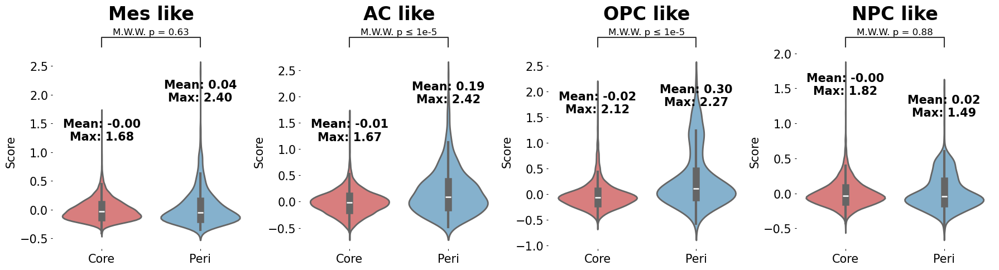

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from statannotations.Annotator import Annotator

# امتیازهایی که باید نمایش داده شوند
score_cols = ['Mes like', 'AC like', 'OPC like', 'NPC like']

# ساخت Subplot ها
fig, axes = plt.subplots(1,4, figsize=(18, 5))
axes = axes.flatten()

# رنگ‌ها برای Core و Peri
palette = {"Core": "#e76f6f", "Peri": "#79b4d9"}

for i, score in enumerate(score_cols):
    ax = axes[i]

    # رسم Violin Plot
    sns.violinplot(
        data=tumor.obs,
        x='site',
        y=score,
        palette=palette,
        ax=ax,
        linewidth=2
    )

    # آماره برای p-value
    core = tumor.obs[tumor.obs['site'] == 'Core'][score].dropna()
    peri = tumor.obs[tumor.obs['site'] == 'Peri'][score].dropna()
    stat, pval = stats.mannwhitneyu(core, peri, alternative='two-sided')

    # نوشتن میانگین و بیشینه
    means = tumor.obs.groupby("site")[score].mean().round(2)
    maxs = tumor.obs.groupby("site")[score].max().round(2)
    for j, site in enumerate(["Core", "Peri"]):
        y_max = tumor.obs[tumor.obs["site"] == site][score].max()
        ax.text(j, y_max * 0.95, f"Mean: {means[site]:.2f}\nMax: {maxs[site]:.2f}",
                ha='center', va='top', fontsize=15, weight='bold')

    # نمایش عنوان در بالای نمودار با فاصله
    ax.text(0.5, 1.15, f"{score}", fontsize=24,
            ha='center', va='bottom', transform=ax.transAxes,weight='bold')

    # رسم p-value با Annotator
    pairs = [("Core", "Peri")]
    annotator = Annotator(ax, pairs, data=tumor.obs, x="site", y=score, order=["Core", "Peri"])
    annotator.configure(
        test='Mann-Whitney',
        text_format='simple',
        loc='outside',
        line_height=0.05,
        fontsize=12
    )
    annotator.apply_and_annotate()

    # برچسب‌های محورها
    ax.set_xlabel("", fontsize=1)
    ax.set_ylabel("Score", fontsize=15)
    # تنظیمات ظاهری subplot

    ax.tick_params(length=2, labelsize=15) # تغییراا سایز عدد ها و کور پری 

    # حذف قاب‌ها
    for spine in ax.spines.values():
        spine.set_visible(False)

# تنظیم نهایی چیدمان
plt.tight_layout(h_pad=0.5, w_pad=0.5)
plt.show()



In [21]:
import pandas as pd

# Replace 'your_file.xlsx' with the path to your Excel file
df = pd.read_excel('/home/fatemeh.nasrabadi/ROVIGO_congas/final/GBM_markers.xlsx', engine='openpyxl')

# Show the first few rows
print(df.tail())


          GPM  log2(fold change)   p-value       FDR  MTC  \
2140  SLC35C1           0.301892  0.003790  0.013534  NaN   
2141    HMGCL           0.301721  0.014505  0.039382  NaN   
2142    CETN2           0.300850  0.008388  0.025476  NaN   
2143   STOML2           0.300443  0.005782  0.018957  NaN   
2144     NKAP           0.300096  0.003463  0.012631  NaN   

      log2(fold change).1  p-value.1  FDR.1  NEU  log2(fold change).2  \
2140                  NaN        NaN    NaN  NaN                  NaN   
2141                  NaN        NaN    NaN  NaN                  NaN   
2142                  NaN        NaN    NaN  NaN                  NaN   
2143                  NaN        NaN    NaN  NaN                  NaN   
2144                  NaN        NaN    NaN  NaN                  NaN   

      p-value.2  FDR.2  PPR  log2(fold change).3  p-value.3  FDR.3  
2140        NaN    NaN  NaN                  NaN        NaN    NaN  
2141        NaN    NaN  NaN                  NaN        

In [22]:
# Drop NaNs and get unique values for each column
gpm_genes = df['GPM'].dropna().unique().tolist()
mtc_genes = df['MTC'].dropna().unique().tolist()
neu_genes = df['NEU'].dropna().unique().tolist()
ppr_genes = df['PPR'].dropna().unique().tolist()

# Now you have four separate gene lists
print("GPM genes:", gpm_genes)
print("MTC genes:", mtc_genes)
print("NEU genes:", neu_genes)
print("PPR genes:", ppr_genes)


GPM genes: ['COL3A1', 'COL1A2', 'TGFBI', 'COL6A3', 'TPBG', 'MET', 'COL1A1', 'NNMT', 'MGST1', 'DAB2', 'CTGF', 'SEMA3C', 'DKK1', 'RCAN2', 'COL13A1', 'COL12A1', 'COL21A1', 'TGM2', 'MFAP2', 'SULF1', 'STRA6', 'JPH2', 'ABCC3', 'ALPK1', 'RGS4', 'DOCK5', 'BNC2', 'ENPP5', 'POPDC3', 'COL8A1', 'CAV1', 'MXRA5', 'HGF', 'THBS1', 'GALNT6', 'MYL9', 'GCNT1', 'BGN', 'SNED1', 'MLPH', 'C3', 'IL1R1', 'ACPP', 'ISLR', 'DHRS3', 'KRT18', 'COL11A1', 'EDIL3', 'CFH', 'PRRX2', 'HMCN1', 'FLI1', 'IFITM1', 'MGP', 'HOXB6', 'COL14A1', 'SLIT3', 'ITGBL1', 'BDKRB2', 'ADAMTSL1', 'MSRB3', 'TNFSF10', 'MME', 'ITGA4', 'TPD52L1', 'CXCL14', 'TGFBR2', 'SPINT1', 'CCL2', 'HOXB5', 'GALNT5', 'ALPK2', 'VDR', 'MOXD1', 'FLRT2', 'PLA2R1', 'MAN1A1', 'LUM', 'CYP1B1', 'MYLK', 'CTSZ', 'IGF1', 'GFPT2', 'ABI3BP', 'PTGER4', 'IGFBP7', 'MSC', 'CD109', 'PLXDC2', 'ADRA1B', 'IL7R', 'KCNN4', 'TUSC3', 'RASL12', 'POSTN', 'IL32', 'EDNRA', 'A4GALT', 'OCIAD2', 'DIO2', 'FLG', 'ME1', 'MFAP5', 'IL15', 'COLEC12', 'MYOF', 'STAC', 'TCIRG1', 'DKK2', 'HOXB9', 'IL

In [23]:

sc.tl.score_genes(tumor , gpm_genes , score_name='GPM like' )

sc.tl.score_genes(tumor , mtc_genes , score_name='MTC like' )

sc.tl.score_genes(tumor , neu_genes , score_name='NEU like' )

sc.tl.score_genes(tumor , ppr_genes, score_name='PPR like' )


                 'FAM196B',           'FAM198B',           'FAM129B',
                  'TMEM56',           'FAM129A',           'RARRES3',
                 'PLA2G16',             'TMEM2', 2019-09-06 00:00:00,
                  'C9orf3',           'C2orf71',            'FAM46A',
                  'KDELC2',             'PQLC3',          'C1orf228',
                  'FBXO18',          'C22orf46',           'C8orf59',
                  'ZCCHC6'],
      dtype='object')
       2019-09-03 00:00:00,          'C14orf37', 2019-03-06 00:00:00],
      dtype='object')


/tmp/ipykernel_1170668/350107698.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_1170668/350107698.py:35: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor.obs.groupby("site")[score].mean().round(2)
/tmp/ipykernel_1170668/350107698.py:36: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = tumor.obs.groupby("site")[score].max().round(2)
/tmp/ipykernel_1170668/350107698.py:20: FutureWarning: 

Passing `palette` without assignin

Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.521e-24 U_stat=1.551e+06
Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.028e-03 U_stat=1.932e+06


/tmp/ipykernel_1170668/350107698.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_1170668/350107698.py:35: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor.obs.groupby("site")[score].mean().round(2)
/tmp/ipykernel_1170668/350107698.py:36: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = tumor.obs.groupby("site")[score].max().round(2)
/tmp/ipykernel_1170668/350107698.py:20: FutureWarning: 

Passing `palette` without assignin

Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:5.151e-29 U_stat=1.501e+06
Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:9.948e-24 U_stat=2.631e+06


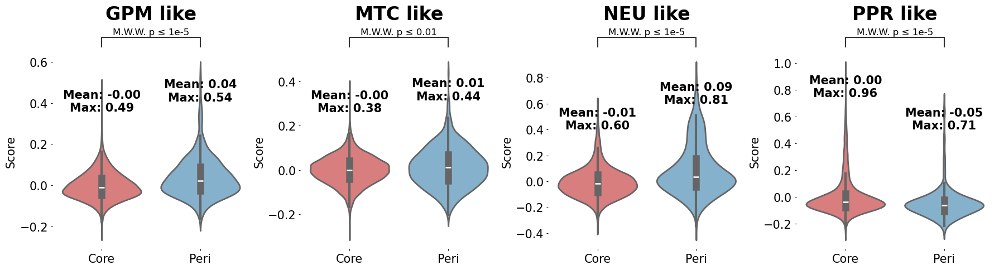

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from statannotations.Annotator import Annotator

# امتیازهایی که باید نمایش داده شوند
score_cols = ['GPM like', 'MTC like', 'NEU like', 'PPR like']

# ساخت Subplot ها
fig, axes = plt.subplots(1,4, figsize=(18, 5))
axes = axes.flatten()

# رنگ‌ها برای Core و Peri
palette = {"Core": "#e76f6f", "Peri": "#79b4d9"}

for i, score in enumerate(score_cols):
    ax = axes[i]

    # رسم Violin Plot
    sns.violinplot(
        data=tumor.obs,
        x='site',
        y=score,
        palette=palette,
        ax=ax,
        linewidth=2
    )

    # آماره برای p-value
    core = tumor.obs[tumor.obs['site'] == 'Core'][score].dropna()
    peri = tumor.obs[tumor.obs['site'] == 'Peri'][score].dropna()
    stat, pval = stats.mannwhitneyu(core, peri, alternative='two-sided')

    # نوشتن میانگین و بیشینه
    means = tumor.obs.groupby("site")[score].mean().round(2)
    maxs = tumor.obs.groupby("site")[score].max().round(2)
    for j, site in enumerate(["Core", "Peri"]):
        y_max = tumor.obs[tumor.obs["site"] == site][score].max()
        ax.text(j, y_max * 0.95, f"Mean: {means[site]:.2f}\nMax: {maxs[site]:.2f}",
                ha='center', va='top', fontsize=15, weight='bold')

    # نمایش عنوان در بالای نمودار با فاصله
    ax.text(0.5, 1.15, f"{score}", fontsize=24,
            ha='center', va='bottom', transform=ax.transAxes,weight='bold')

    # رسم p-value با Annotator
    pairs = [("Core", "Peri")]
    annotator = Annotator(ax, pairs, data=tumor.obs, x="site", y=score, order=["Core", "Peri"])
    annotator.configure(
        test='Mann-Whitney',
        text_format='simple',
        loc='outside',
        line_height=0.05,
        fontsize=12
    )
    annotator.apply_and_annotate()

    # برچسب‌های محورها
    ax.set_xlabel("", fontsize=1)
    ax.set_ylabel("Score", fontsize=15)
    # تنظیمات ظاهری subplot

    ax.tick_params(length=2, labelsize=15) # تغییراا سایز عدد ها و کور پری 

    # حذف قاب‌ها
    for spine in ax.spines.values():
        spine.set_visible(False)

# تنظیم نهایی چیدمان
plt.tight_layout(h_pad=0.5, w_pad=0.5)
plt.show()


# umap plot of signatures

In [3]:
t = sc.read("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

In [4]:
t

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source', 'leiden', 'patient_zone', 'S_score', 'G2M_score', 'phase'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'patient_colors', 'patient_zone_colors', 'pca', 'phase_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [25]:
tumor

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source', 'leiden', 'patient_zone', 'S_score', 'G2M_score', 'phase', 'Mes like', 'AC like', 'OPC like', 'NPC like', 'GPM like', 'MTC like', 'NEU like', 'PPR like'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'patient_colors', 'patient_zone_colors', 'pca', 'phase_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [29]:
# Create t as a copy of tumor (or your subset if already defined)


# Add specific obs columns from tumor to t
t.obs['Mes like'] = tumor.obs['Mes like']
t.obs['AC like'] = tumor.obs['AC like']
t.obs['OPC like'] = tumor.obs['OPC like']
t.obs['NPC like'] = tumor.obs['NPC like']
t.obs['GPM like'] = tumor.obs['GPM like']
t.obs['MTC like'] = tumor.obs['MTC like']
t.obs['NEU like'] = tumor.obs['NEU like']
t.obs['PPR like'] = tumor.obs['PPR like']


In [30]:
t

AnnData object with n_obs × n_vars = 8121 × 36601
    obs: 'site', 'patient', 'patientzone', 'source', 'leiden', 'patient_zone', 'S_score', 'G2M_score', 'phase', 'Mes like', 'AC like', 'OPC like', 'NPC like', 'GPM like', 'MTC like', 'NEU like', 'PPR like'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'patient_colors', 'patient_zone_colors', 'pca', 'phase_colors', 'site_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [31]:
tumor = t

In [ ]:
t.write("/scratch/fatemeh.nasrabadi/importsnt/THESIS_FINAL/10Samples/FINALIZED_GEX_INTEGRATED/Tumor_Umap_harmoney8121.h5ad")

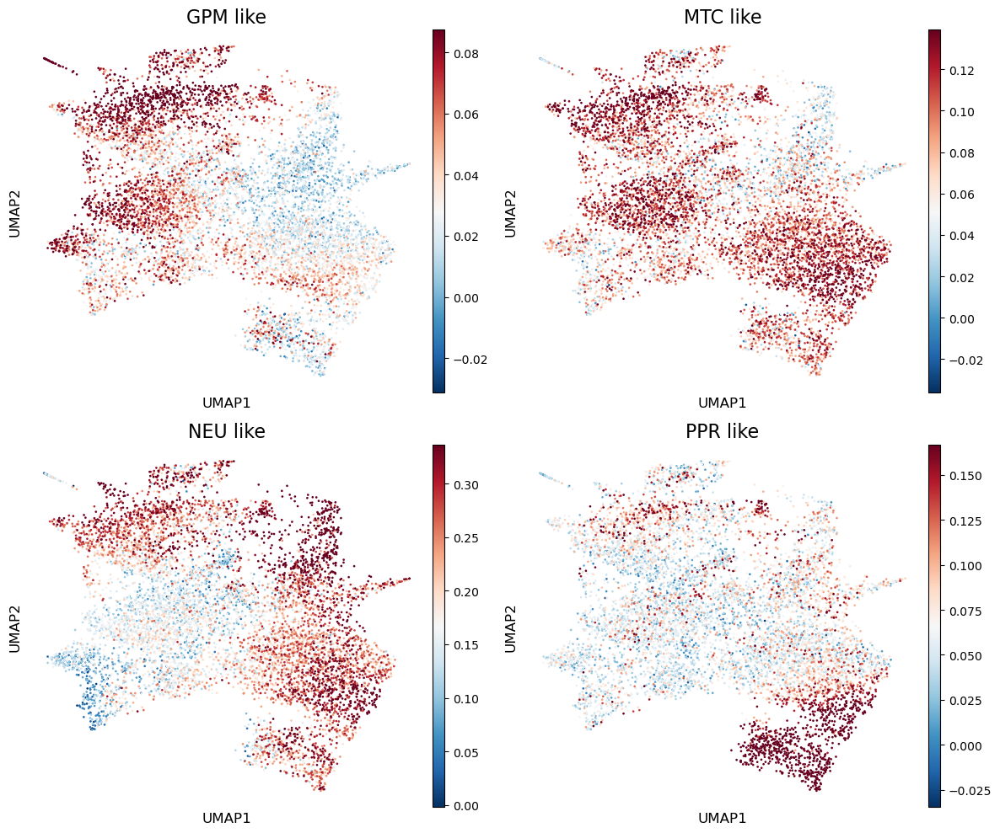

In [36]:
import matplotlib.pyplot as plt
import scanpy as sc

# Define the list of features to plot
umap_features = ['GPM like', 'MTC like', 'NEU like', 'PPR like']

# Create a 2x2 figure with minimal spacing
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Plot each feature on its own subplot
for i, feature in enumerate(umap_features):
    row = i // 2
    col = i % 2
    ax = axes[row, col]

    sc.pl.umap(
        tumor,
        color=feature,
        ax=ax,
        show=False,
        frameon=True,
        cmap="RdBu_r",
        vmax='p90'  # percentile-based scaling (keeps upper 10% of values)
    )

    ax.set_title(feature, fontsize=16)
    ax.set_xlabel("UMAP1", fontsize=12)
    ax.set_ylabel("UMAP2", fontsize=12)
    ax.tick_params(length=2, labelsize=10)

    # Remove outer frame
    for spine in ax.spines.values():
        spine.set_visible(False)

plt.tight_layout()
plt.show()


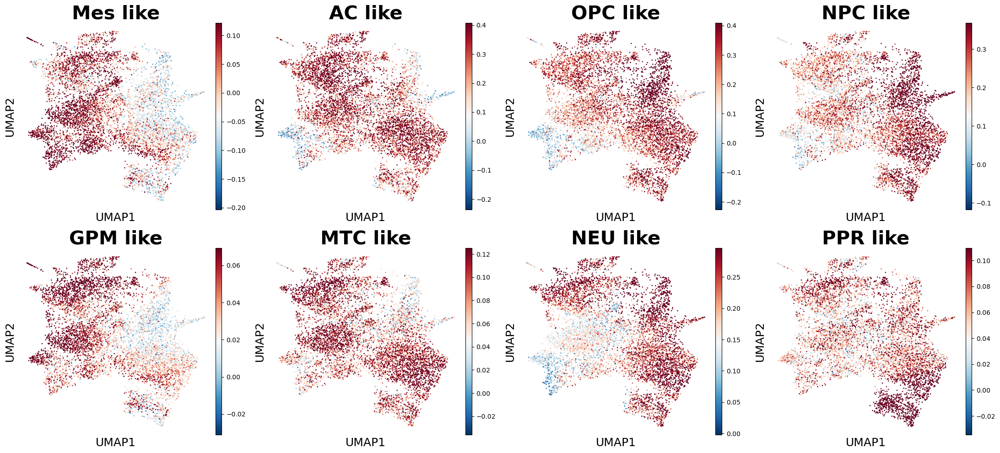

In [49]:
import matplotlib.pyplot as plt
import scanpy as sc

# === All 8 features ===
umap_features = [
    'Mes like', 'AC like', 'OPC like', 'NPC like',
    'GPM like', 'MTC like', 'NEU like', 'PPR like'
]

# === Create 2x4 figure ===
fig, axes = plt.subplots(2, 4, figsize=(22, 10))
plt.subplots_adjust(wspace=0.1, hspace=0.1)

# === Plot each feature ===
for i, feature in enumerate(umap_features):
    row = i // 4
    col = i % 4
    ax = axes[row, col]

    sc.pl.umap(
        tumor,
        color=feature,
        ax=ax,
        show=False,
        frameon=True,
        cmap="RdBu_r",
        vmax='p80'
    )

    ax.set_title(feature, fontsize=30,weight='bold')
    ax.set_xlabel("UMAP1", fontsize=18)
    ax.set_ylabel("UMAP2", fontsize=18)
    ax.tick_params(length=2, labelsize=17)

    # Remove outer frame
    for spine in ax.spines.values():
        spine.set_visible(False)

# === Tidy layout ===
plt.tight_layout()
plt.show()


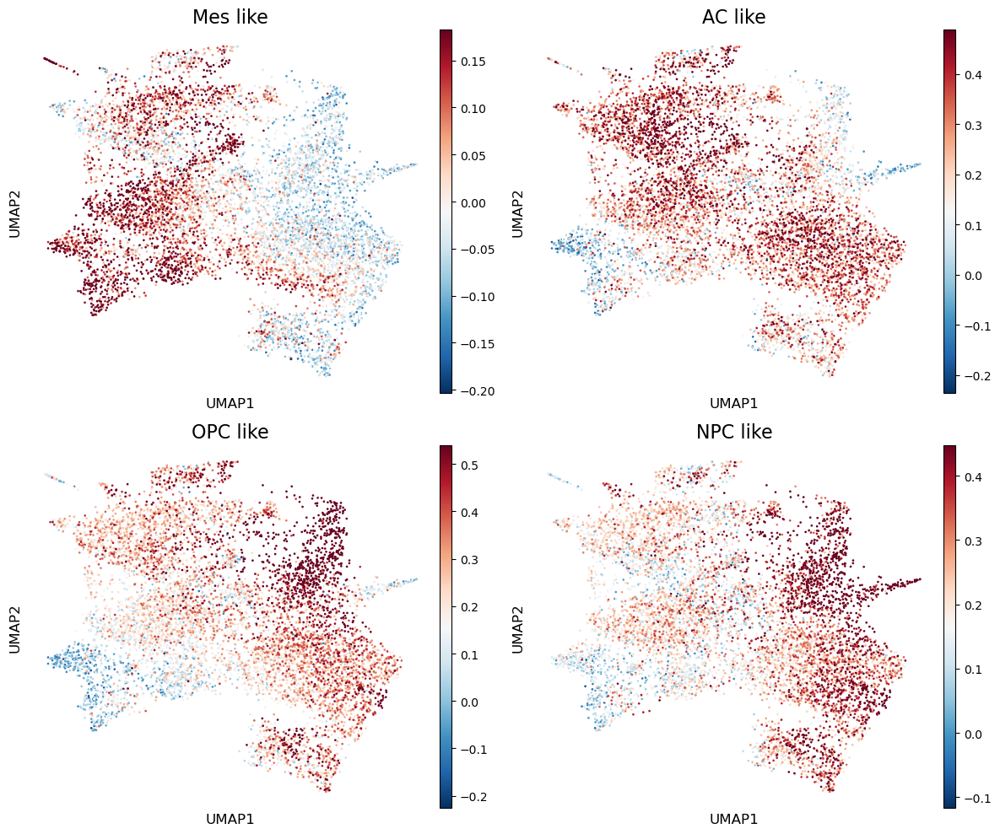

In [48]:
import matplotlib.pyplot as plt
import scanpy as sc

# Define the list of features to plot
umap_features = ['Mes like', 'AC like', 'OPC like', 'NPC like']

# Create a 2x2 figure with minimal spacing
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Plot each feature on its own subplot
for i, feature in enumerate(umap_features):
    row = i // 2
    col = i % 2
    ax = axes[row, col]

    sc.pl.umap(
        tumor,
        color=feature,
        ax=ax,
        show=False,
        frameon=True,
        cmap="RdBu_r",
        vmax='p90'  # percentile-based scaling (keeps upper 10% of values)
    )

    ax.set_title(feature, fontsize=16)
    ax.set_xlabel("UMAP1", fontsize=12)
    ax.set_ylabel("UMAP2", fontsize=12)
    ax.tick_params(length=2, labelsize=10)

    # Remove outer frame
    for spine in ax.spines.values():
        spine.set_visible(False)

plt.tight_layout()
plt.show()


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.866e-12 U_stat=3.551e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:4.108e-08 U_stat=1.771e+05


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.909e-04 U_stat=9.472e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.169e-02 U_stat=5.197e+03


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:9.309e-10 U_stat=2.318e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:4.759e-06 U_stat=3.192e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.058e-34 U_stat=1.248e+05


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.668e-04 U_stat=9.357e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:9.107e-01 U_stat=3.729e+03


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.432e-01 U_stat=1.097e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.789e-31 U_stat=8.299e+03


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:8.003e-02 U_stat=2.057e+05


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.357e-05 U_stat=4.004e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:6.588e-03 U_stat=5.306e+03


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.506e-03 U_stat=7.387e+03


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.970e-23 U_stat=1.077e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.819e-07 U_stat=2.593e+05


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.861e-02 U_stat=5.488e+04


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:6.206e-03 U_stat=5.317e+03


/tmp/ipykernel_2255777/2038635370.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/2038635370.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/2038635370.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:9.499e-01 U_stat=1.272e+04


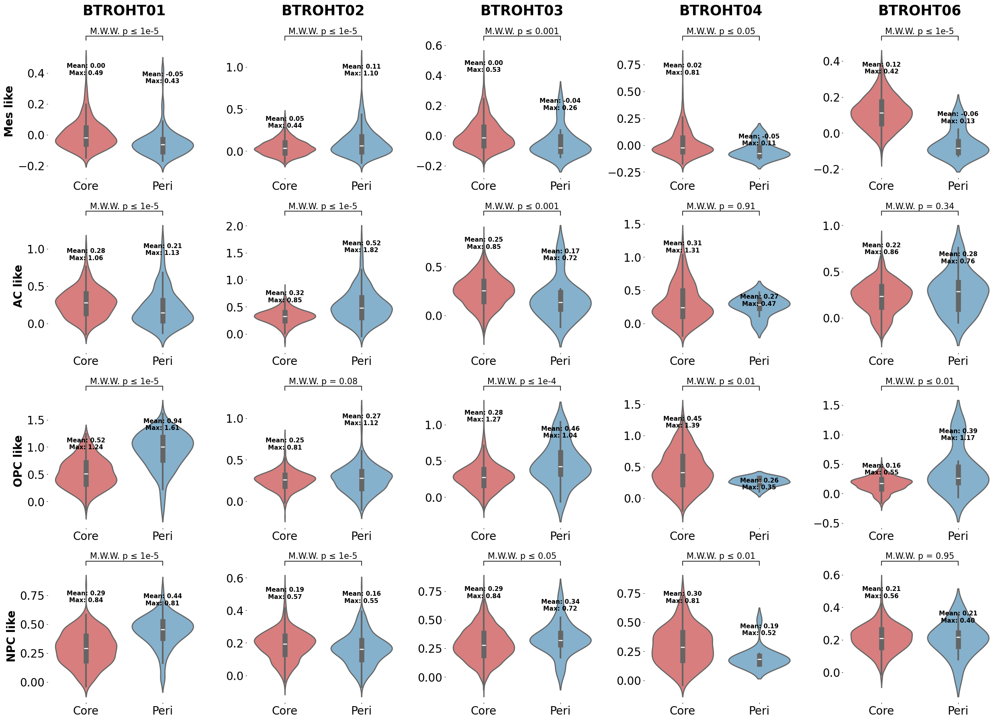

In [39]:
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from statannotations.Annotator import Annotator

# Base config
palette = {"Core": "#e76f6f", "Peri": "#79b4d9"}
signatures = [
    "Mes like", "AC like", "OPC like", "NPC like",
]
patients = ["BTROHT01", "BTROHT02", "BTROHT03", "BTROHT04", "BTROHT06"]

# Create figure with 8 rows × 5 columns
nrows, ncols = len(signatures), len(patients)
fig, axes = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4.5 * nrows))
axes = axes.reshape(nrows, ncols)

for row, sig in enumerate(signatures):
    for col, patient in enumerate(patients):
        ax = axes[row][col]
        data = tumor.obs[tumor.obs['patient'] == patient]

        # Violin plot
        sns.violinplot(
            data=data,
            x='site',
            y=sig,
            palette=palette,
            ax=ax,
            linewidth=2
        )

        # Statistical test
        core = data[data['site'] == 'Core'][sig].dropna()
        peri = data[data['site'] == 'Peri'][sig].dropna()
        if not core.empty and not peri.empty:
            stat, pval = stats.mannwhitneyu(core, peri, alternative='two-sided')
        else:
            pval = None

        # Mean & Max annotation
        means = data.groupby("site")[sig].mean().round(2)
        maxs = data.groupby("site")[sig].max().round(2)
        for j, site in enumerate(["Core", "Peri"]):
            if site in data['site'].values:
                y_max = data[data["site"] == site][sig].max()
                ax.text(j, y_max * 0.95, f"Mean: {means[site]:.2f}\nMax: {maxs[site]:.2f}",
                        ha='center', va='top', fontsize=11, weight='bold')

        # Patient label (top of each column)
        if row == 0:
            ax.text(0.5, 1.2, f"{patient}", fontsize=25,
                    ha='center', va='bottom', transform=ax.transAxes, weight='bold')

        # Signature label (start of each row)
        if col == 0:
            ax.set_ylabel(f"{sig}", fontsize=20, weight='bold')
        else:
            ax.set_ylabel("")

        ax.set_xlabel("")

        # Annotator
        pairs = [("Core", "Peri")]
        annotator = Annotator(ax, pairs, data=data, x="site", y=sig, order=["Core", "Peri"])
        annotator.configure(
            test='Mann-Whitney',
            text_format='simple',
            loc='outside',
            line_height=0.03,
            fontsize=15
        )
        annotator.apply_and_annotate()

        # Clean up look
        ax.tick_params(length=2, labelsize=20)
        for spine in ax.spines.values():
            spine.set_visible(False)

# Final layout
plt.tight_layout(h_pad=2.0, w_pad=1.5)
plt.show()


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.601e-05 U_stat=3.139e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:8.980e-05 U_stat=2.493e+05


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:9.484e-09 U_stat=2.966e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.303e-08 U_stat=7.140e+02


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.456e-02 U_stat=1.683e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.455e-01 U_stat=2.739e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:6.703e-07 U_stat=2.574e+05


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.645e-01 U_stat=5.954e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.835e-10 U_stat=3.040e+02


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.587e-01 U_stat=1.420e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:8.973e-10 U_stat=1.636e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:6.073e-12 U_stat=2.720e+05


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.159e-10 U_stat=2.587e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:6.124e-04 U_stat=1.883e+03


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:4.800e-08 U_stat=3.179e+03


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:8.400e-01 U_stat=2.498e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:5.623e-19 U_stat=2.875e+05


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.474e-04 U_stat=9.427e+04


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.710e-03 U_stat=2.175e+03


/tmp/ipykernel_2255777/849133844.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/849133844.py:42: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = data.groupby("site")[sig].mean().round(2)
/tmp/ipykernel_2255777/849133844.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs = data.groupby("site")[sig].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.035e-01 U_stat=1.481e+04


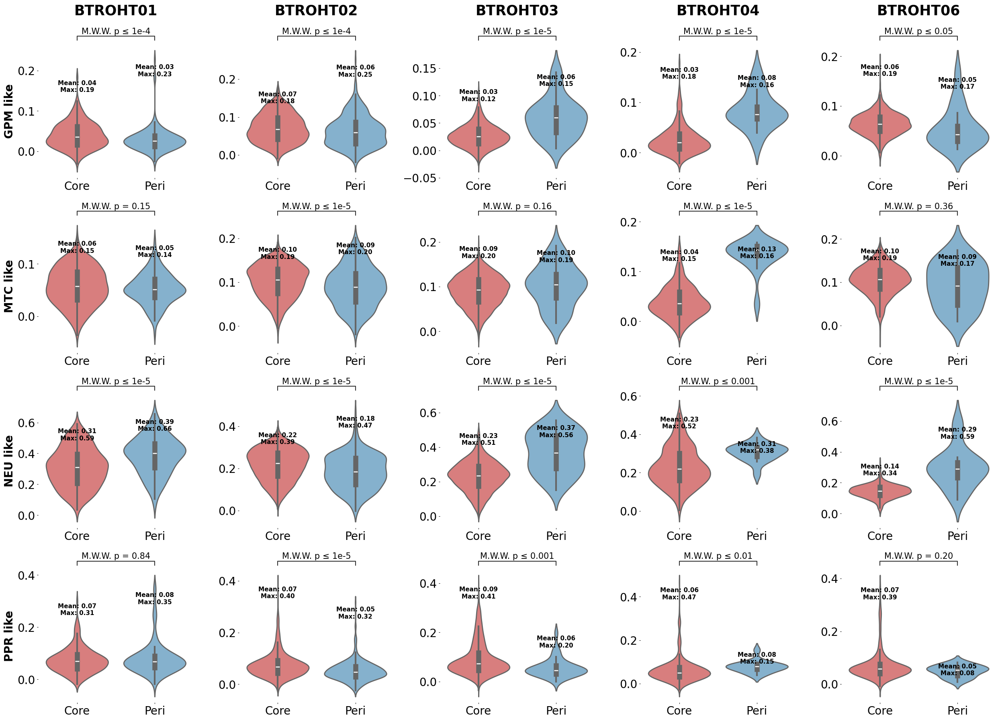

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from statannotations.Annotator import Annotator

# Base config
palette = {"Core": "#e76f6f", "Peri": "#79b4d9"}
signatures = [
      "GPM like", "MTC like", "NEU like", "PPR like"
]
patients = ["BTROHT01", "BTROHT02", "BTROHT03", "BTROHT04", "BTROHT06"]

# Create figure with 8 rows × 5 columns
nrows, ncols = len(signatures), len(patients)
fig, axes = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4.5 * nrows))
axes = axes.reshape(nrows, ncols)

for row, sig in enumerate(signatures):
    for col, patient in enumerate(patients):
        ax = axes[row][col]
        data = tumor.obs[tumor.obs['patient'] == patient]

        # Violin plot
        sns.violinplot(
            data=data,
            x='site',
            y=sig,
            palette=palette,
            ax=ax,
            linewidth=2
        )

        # Statistical test
        core = data[data['site'] == 'Core'][sig].dropna()
        peri = data[data['site'] == 'Peri'][sig].dropna()
        if not core.empty and not peri.empty:
            stat, pval = stats.mannwhitneyu(core, peri, alternative='two-sided')
        else:
            pval = None

        # Mean & Max annotation
        means = data.groupby("site")[sig].mean().round(2)
        maxs = data.groupby("site")[sig].max().round(2)
        for j, site in enumerate(["Core", "Peri"]):
            if site in data['site'].values:
                y_max = data[data["site"] == site][sig].max()
                ax.text(j, y_max * 0.95, f"Mean: {means[site]:.2f}\nMax: {maxs[site]:.2f}",
                        ha='center', va='top', fontsize=11, weight='bold')

        # Patient label (top of each column)
        if row == 0:
            ax.text(0.5, 1.2, f"{patient}", fontsize=25,
                    ha='center', va='bottom', transform=ax.transAxes, weight='bold')

        # Signature label (start of each row)
        if col == 0:
            ax.set_ylabel(f"{sig}", fontsize=20, weight='bold')
        else:
            ax.set_ylabel("")

        ax.set_xlabel("")

        # Annotator
        pairs = [("Core", "Peri")]
        annotator = Annotator(ax, pairs, data=data, x="site", y=sig, order=["Core", "Peri"])
        annotator.configure(
            test='Mann-Whitney',
            text_format='simple',
            loc='outside',
            line_height=0.03,
            fontsize=15
        )
        annotator.apply_and_annotate()

        # Clean up look
        ax.tick_params(length=2, labelsize=20)
        for spine in ax.spines.values():
            spine.set_visible(False)

# Final layout
plt.tight_layout(h_pad=2.0, w_pad=1.5)
plt.show()


In [50]:
# HOTSPOT

In [51]:
import re
from collections import defaultdict

raw_text = """

=== Module 1 ===
AC009041.2
PDGFRA
AC110285.1
AL359091.1
DLX6-AS1
LINC02283
CADM2
SOX6
TNR
DSCAM
SCN3A
FGF12
BCAN
GALNT13
OLIG1
BCAS1
OPCML
MARCH1
NNAT
GPR17
DLL3
MYRF
AATK
KCNS3
PCDH15
SMOC1
BMPER
LRRTM4
SIRT2
FERMT1
AL512308.1
GRIK2
PKP4
EPB41L2
LRRC4C
DSCAML1
DGKB
FRMD4A
TNS3
SNX22
P2RX7
TNK2
ZNF536
COL20A1
ACAP3
NTM
SLC44A1
ADAM33
TMEFF2
OPHN1
PPP1R16B
PHACTR3
LSAMP
CA10
IL1RAPL1
MDGA2
CNTN1
TMEM108
PTPRS
FRMD5
EPHB1
DNM3
GRIA4
AC004852.2
PCDH7
SCD5
CACNA1A
MEGF11
TMEM132B
DOCK10
DLG1
KAZN
HES6
LCNL1
ENPP6
LINC01170
PLPPR1
ZEB2
SLC16A10
RASGEF1B
VIPR2
AC060834.2
AL355306.2
LUZP2
SGK1
KLRC2
SEMA5B
AC006058.1
PHYHIPL
DOCK6
PLCB1
ATCAY
ALCAM
AC073365.1
DNER
KIF21B
SHD
ERBB3
SOX8
SRCIN1
FRMD4B
COL11A1
GPC6
TNS2
KCNH8
SEMA4D
CDK18
SOX10
KLRC3
SHANK2
RIMS1
UNC80
ANO3
EYS
UGT8
NTN1
REPS2
NKD1
CDH13
ARPP21
FAM110B
GNAI1
DLL1
NEU4
PCDH11X
NFASC
SH3RF3
KCNMB2
KHDRBS3
PRICKLE1
FOXP2
RNF144A
ASIC1
TTC9B
MMP17
FBN3
PTPRO
EYA1
CELF3
SCG3
LINC00599
CSPG5
STK32B
FXYD6
C1QL1
TMEM163
HIP1R
ADRA1A
AFAP1L2
SPNS2
POLR2F
ZNF804A
APCDD1
TRAF4
GNAO1
COL9A1
RASGEF1C
LINC02268
OLIG2
AMOTL2
BTBD17
SLC22A17
SGCD
GADD45G
GRIK4
AF121898.1
CDKN1C
BRSK2
MCF2L
MICAL1
ASIC4
NXN
LINC01505
SIM2
ADAMTSL1
AL161910.1
AC124852.1
VSTM2B
PDE3B
AC110285.2
ELAVL3
PRKAR1B
CRISPLD2
PCBP4
DACH2
PLEKHA6
KANK2
COL9A2
SLC8A3
GSE1
IGSF21
AC068308.1
BAHCC1
CHD3
RUNDC3A
CACNG4
AL445250.1
LINGO1
DNAH10
TXNIP
HID1
SAPCD2
RCOR2
ANKRD13B
CELF5
KIAA1755
MIR503HG
NOL4L
AC005562.1
MCAM
NLGN2
RAB3C
BCL11B
PFN2
CD82
ASCL1
CSPG4
PDGFA
AL136114.1
GPC2
LPAR2
IQCJ-SCHIP1
AL353784.1
MALRD1
EMILIN3
PODXL2
ABCG1
MYH14
CCND1
MMP2
KDM6B
ADAMTS17
CPXM1
AC113370.1
AL133325.3
MAST1
SRRM3
PRKCZ
MEX3B
OMG
LIMD2
FSCN1
AC092422.1
RAB27B
RAB11FIP4
MXD4
ABCA13
KIF19
NRG2
AL391840.1
NARF
PCDH11Y
HECW1
ABTB2
TIMM50
EMC10
RCL1
AP000721.2
CFAP20
NPAS1
SLC29A4
DNAJB5
RAP2A
NDRG3
EML2
LINC02774
AC012447.1
UGDH
SNHG17
ARL4A
CFTR
SLC39A6
TMEM160
POMGNT2
STOML2
TMEM25

=== Module 2 ===
GAPDH
TUBA1A
RPL41
SCRG1
S100A6
B2M
RPL37A
TIMP1
RPS15
RPS28
MARCKS
RPS27
RPL38
EEF1A1
DBI
LGALS1
COX6A1
RPL39
MARCKSL1
RPS18
NDUFA4
RPLP2
RPL13A
RPLP1
RPL28
RPS19
RPS27A
RPL19
RPS14
PTMA
FAU
RPL35
RPL36
RPL32
PRDX1
RPL35A
RPS10
RPL13
MIF
TMSB10
RPL18
RPL18A
SSR4
RPL23
RPS21
NDUFA13
RPL30
PEBP1
RPS11
RPL34
RPL27A
RPL11
RPS29
RPS23
RPS17
UBA52
RPL23A
RPS24
COX7C
RPL24
CNP
RPL27
RPL8
RPL7A
PPIB
RNASEK
RPL29
RABAC1
RPL15
RPL37
MYL6
EIF1
RPS16
SERF2
RPL9
TUBA1B
RPS25
RPS2
RPL26
RPL14
RPS9
TOMM7
SYT11
ATP5F1E
PGRMC1
RPL21
COX8A
RPS20
RPS13
H3F3B
ARL6IP1
RPS26
SCG5
RPS12
RPS3A
HSPA8
CFL1
TPT1
DYNLL1
RPS8
UQCRQ
C4orf48
SRP14
CHCHD2
NDUFC2
RPS7
RPS5
RPL7
UBL5
GPX4
TMEM258
COX4I1
RPL6
COX6B1
ATP5ME
NDUFB11
CALR
GSTP1
NDUFS5
TECR
ELOB
RPS6
RPL31
ATP5MF
COX6C
EEF1G
NDUFB2
PHPT1
PRDX2
RPS15A
PFN1
H3F3A
KRTCAP2
RPSA
TMA7
RPL17
CUTA
BSG
RPL3
RPL12
NDUFB7
UQCRB
HINT1
AURKAIP1
RPS3
NDUFA3
POLR2L

=== Module 3 ===
CERCAM
PLP1
MBP
CARNS1
ABCA2
CLDN11
TF
PLEKHH1
MOG
TMEM144
CNTN2
SPOCK3
MAP7
EDIL3
MAN2A1
DOCK5
CNTNAP4
NKAIN2
CTNNA3
ENPP2
SLC24A2
ST18
PWRN1
PTPRK
MOBP
LRP2
KLHL32
PIP4K2A
PCSK6
RNF220
PEX5L
C10orf90
RAB40B
SEPTIN4
ANKS1B
RNASE1
TMEM235
MAG
SLC5A11
PHLDB1
APLP1
PLCL1
SLCO1A2
SEMA3B
SLC7A14-AS1
HAPLN2
CNDP1
SGIP1
DAAM2
DLC1
AK5
NT5DC1
BIN1
SVEP1
ADAMTS18
CAMK2N1
ERC2
TMPRSS5
AC008571.2
CAPN3
HDAC2-AS2
BEST1
CD22
RASGRF2
CLDND1
SLC25A27
NALCN
LPAR1
RAPGEF5
KIRREL3
CLMN
ST6GALNAC3
QDPR
FUT9
LMCD1-AS1
RGCC
AMER2
SEC14L5
DBNDD2
PLD1
LURAP1L-AS1
DOCK9
ANO4
AC012494.1
KIAA0930
KIAA1324L
EFHD1
ENOX1
PLA2G4C
ASPA
ZDHHC11B
ARHGAP23
LGR5
SELENOP
MTURN
AC096564.1
HECW2
SNORC
PPM1H
NECAB1
TMEM107
TP53TG5
AMPD3
SELENOW
RPS6KA5
INPP5F
ADCY5
MAST3
CDH1
CDKL5
CPPED1
AF165147.1
CPB2-AS1
ANAPC16

=== Module 4 ===
CTNNA2
ATP1A2
ROBO3
RYR3
COL4A5
COL28A1
AEBP1
CACNA2D1
SCN1A
THSD7A
CFAP54
ERBB4
COL5A3
AHCYL1
NEGR1
COL16A1
SERPINE1
SLC44A5
DNAH7
AC002460.2
RMST
GPC5
FGFR3
NAV3
KCTD8
FAM155A
IGF2BP2
HYDIN
STXBP5L
IFI44L
PACRG
CSMD3
ITGB4
AC006148.1
LINC01876
ZNF783
ABCA1
VWA3A
NRG3
APC2
MICALL2
GLUL
LFNG
ATN1
AC012405.1
COL8A1
MGAT4C
DGKI
AL606923.2
CADPS2
PTCHD4
LMO2
CNR1
CFAP70
SEMA3C
ZFP36
GRM5
PPFIA2
F3
GRIK1
DDR1
EGR1
FOS
LENG8
PRKG1
STAT2
ABCC3
DPH6-DT
MX1
NRXN3
SEMA3E
MEIS2
COL22A1
AL353138.1
HHIP
AC233296.1
NTNG1
ELN
PCLO
SPATA17
KCNMA1
ANXA1
LINC00632
DNM1
KAT2A
DACH1
UNC79
GRIA1
PHACTR1
TTYH1
PTCH1
DNAH6
ZIC1
SYNJ2
INPP4B
ZMIZ2
COL6A1
ZYX
LGI4
EPS8L2
VGF
LONRF2
ACADVL
SORBS2
HLA-B
TMOD1
CNTN5
SCN1A-AS1
CPSF4
ITGA3
ZFP36L2
KIAA1211L
AC007389.1
SLIT2
TRIM22
GRINA
ANO8
RGL2
ARC
LINC00882
DUSP1
NETO2
PARP10
PPL
MYO15B
GPR158
TRIP6
AL513166.1
PLTP
EML6
RALYL
PLXND1
AC107464.1
AC012078.2
SAMD3
PCED1B
MIR31HG
INPPL1
PTCH2
MST1
TAFA2
PTPRF
SOX9
EMP1
SPEG
AC011287.1
MDM2
KNDC1
VWCE
TMEM176B
TNXB
FREM1
BACH2
AL355974.2
FXYD5
PLAT
DRC7
COL21A1
SPAG8
P3H2
COL4A6
GADD45A
PDXK
HULC
SLC20A1
RCAN1
WDR63
HS3ST3A1
ITGA2
RORB
LRGUK
NEBL
PGGHG
AC105411.1
AC092131.1
SNHG31
RNF166
AC005999.2
CAV1
SCNN1D
LINC01122
LINC01117
TUBE1
TPM2
UPP2
FBXO32
LINC02055
PHYHD1
AC073114.1
AC011346.1
KLKB1
ETFDH
SCN11A
SPAG1
C7orf61
STEAP2-AS1
DTX1
AL022068.1
CCS
HOXD9
POU6F2
NECAB3
BAIAP2
ITPR3
ABHD11
FDXR
DXO
SNX8
UBE2L3
HMGA1
HEY2
HMGA1P4
AC026341.1
PHLDA3
LAT

=== Module 5 ===
NEAT1
SMYD3
ATRNL1
XIST
ALK
OXR1
ANKRD10
NRP2
CD63
AC124254.2
CADPS
HMGCS1
GAP43
E2F7
XKR4
ADAMTS9
ZNF385D
PRUNE2
MGST1
VMP1
AC109466.1
CHL1
AC016042.1
CHSY3
AL008633.1
AC090579.1
MOXD1
HIVEP3
CCDC102B
CD44
ACSL6
LMO3
LDLR
AL589740.1
CPED1
GALR1
DPYD
AC244502.1
CHI3L1
NAMPT
THBS2
ADGRL2
SCD
BEST3
DMGDH
ARF4
LINC00299
HAP1
SERINC5
MAP1B
SLC4A10
ARSJ
SILC1
NPAS2
PCA3
ADAM32
DEC1
PYGL
PBX3
HGF
LAMB4
PDE3A
LTBP1
VAV3
ST6GALNAC5
NELL2
EXTL3
HMGA2
RDH10
UBA6-AS1
PGM2L1
RGS17
NCKAP5
KCNQ1OT1
SLC1A2
FREM2
PDE8B
UNC5C
LZTS1
UCHL1
FAM20C
NIBAN1
ROR1
CREB5
AC004158.1
CDH6
TNC
NEK10
MECOM
WWTR1
SLC38A1
PLS3
MIR222HG
MEG8
AC008591.1
CALCRL
COL5A2
KLHL29
KIF26B
ITPKB
OSMR
ADAM12
SNED1
XPOT
NRP1
IQGAP2
CYTOR
ST8SIA5
ALDH1L2
HSD17B14
FABP5
LINC01515
MYRFL
HIF1A-AS3
PCSK1N
KDELR2
COL4A2
LINC01060
HSPA5
IGFBP3
IPCEF1
DNAH14
AC019068.1
MVD
FILIP1L
AC007364.1
BRINP2
ADAMTS1
COL4A1
MIR22HG
CLIC4
ECM1
HS6ST2
AL357507.1
LINC02328
MCUB
TERF2IP
PLPP7
GAS1
ANGPTL2
CTSL
TCEAL9
AC119674.1
ASB18
AC073343.2
AC008415.1
AC013391.2
EMX2
P4HA2
AC104365.1
ATF3
LARP6
AL139317.5
AC023051.1
AC079142.1
GDF15
AC018616.1
AL356108.1
LINC01579
RARRES1
BBOX1-AS1
LINC02234
AC068286.2
ELMSAN1
CHRM5
LINC01268
AC083837.1
TMEM150C
ESR2
ZBTB21
AC127164.1
AC090772.2
CDR2
LINC00276
SYNC
AL109628.2
NFE2L3
NFIL3
SLC7A6OS
AL078459.1
DLGAP1-AS1
SLC26A5
AC008119.1
ASIP
RBIS
CXorf56
WDR89
YIPF5

=== Module 6 ===
PCDH9
DCC
RGS6
DMD
KCNIP4
CPNE4
FAT3
NKAIN3
PDE4D
CDH19
GABRB1
LIFR
COL25A1
GLIS3
TRPM3
PXDNL
AC092957.1
PCDH9-AS2
CHST8
LHFPL6
LINC01949
PTPRT
AL160254.1
SLC24A3
GALNT17
CDH4
AC064875.1
LINC02821
LIMD1
SPRED1
LGR4
FOXG1
TRIM2
PTPRD
PDGFD
PALM2-AKAP2
AC110296.1
TNFRSF19
AC073050.1
TAFA5
AC092691.1
CSGALNACT1
MEIS1
LPL
SOCS2
EPHA4
PDE1A
PLCB4
CLVS1
ANK3
PLXNA4
MEOX2
DLGAP1
LUCAT1
ZFPM2-AS1
LAMA1
KCNH1
SEPTIN9
RIMS2
CACNG5
MCTP1
LRRTM3
CDH8
NCALD
FBN2
SLC8A1-AS1
C3orf70
MIPOL1
AL354771.1
RUNX1
A2M
STAC2
CDH7
CPNE8
MGMT

=== Module 7 ===
KCND2
GRID2
AC007402.1
GLCCI1
FGF14
MMP16
PAK3
PTPRZ1
EGFR
VCAN
CSMD1
NOVA1
AC002069.2
MIRLET7BHG
NXPH1
SEZ6L
HIP1
IGSF9B
SLC2A13
BRINP3
CCND2
PTPRN2
MYT1
PID1
EPN2
C2orf27A
CHST11
MTSS1
CHD7
CASC15
SEMA5A
ETV1
TOX3
SLAIN1
CHST9
KCNH7
SOX5
AC007319.1
ATP8A1
CDH20
TFDP2
AC099792.1
DCX
REV3L
SLIT1
SOX4
EGFR-AS1
LINC01322
UHRF1
LINC01748
MTAP
AC003991.1
VCAN-AS1
ELAVL4
DOK6
TTTY14
SEZ6
USP54
ZNF804B
AL110292.1
PPM1E
BCHE
AC090578.1
ZC4H2
GNG4
AC079304.1

=== Module 8 ===
CST3
PTGDS
CRYAB
HBB
MT3
ACTB
CD81
IGFBP7
GJA1
ATP1B2
CLU
RARRES2
SPARC
ITM2C
HBA2
FTL
VIM
S100B
CKB
FTH1
TMSB4X
HBA1
S100A10
ACTG1
NDRG2
AQP1
CHI3L2
RPL10
AGT
CALM1
FLNC
GPR37L1
AQP4
C3
TUBB2B
FXYD1
APOE
CSRP1
IFITM3
GABARAP
PSAP
PRNP
NAT8L
COX5B
ATP6V0C
B4GAT1
PLEKHB1
GPRC5B
TMEM205
RHOB
IFI27L2
GABARAPL2
CTSD
BLOC1S1
DYNLRB1

=== Module 9 ===
GFAP
KIT
NKAIN4
EEPD1
MMD2
NTRK2
ID3
HES4
KCNQ5
ATP10B
NCAN
OSBPL11
ID4
PLXNB1
ARHGEF4
SNHG25
B4GALNT4
PSD2
PLEKHA5
PILRB
AL391807.1
FAM189A2
LAMA4
TOGARAM2
SPTAN1
ALDOC
KCNN3
GINS3
NRBP2
RNF213
WDR6
AC002429.2
SHISA9
BAIAP3
HIF3A
NSMF
MRVI1
XAF1
LINC01896
NPDC1
LTBP4
CDK9
MAT2A
ALDH1L1
OBI1-AS1
MEGF10
PRRT2
FAM107A
RGS7
OLFM2
PER1
PAGR1
PLEC
MTSS2
AC234582.1
OGFRL1
GALNT15
AL121827.2
SLC6A1
AMH
ATP1B1
TPCN1
LZTS3
SMOC2
CRISPLD1
RHPN1
MAFK
TSPOAP1
AL109809.5
ASAP3
PDE4DIP
MIIP
ALDH4A1
MTX1
C1orf198
OGFR
WDR45
PDZD4
IQCA1
LENG9
BX255925.3
PAQR6
TMEM132A
GTPBP3
PEG3
AP006621.3

=== Module 10 ===
VEGFA
SEC61G
PLCG2
CHRM3
HILPDA
ADAMTS9-AS2
GBE1
AFF3
AC011228.2
DNAH11
ANKRD28
PTCHD1-AS
IGFBP2
NEDD4L
ADCY8
PGK1
SLC35F4
AKAP12
ID2
IGFBP5
SORCS3
PLOD2
NDRG1
AC073332.1
PDK1
SAMD4A
HDAC9
AL357153.2
ADM
ELL2
SPOCK1
ARRDC3
TOX
CA12
AL354733.3
IL1RAP
IRS2
ADAM9
MRTFA
INSIG2
OSBP2
SLC16A1
SLC12A2
AC074351.1
SHISA6
GRB10
AC097534.2
RPS27L
KCNMB2-AS1
AMD1
MYO1E
DOK5
SLC22A23
ARL4C
LGALS3
C12orf40
FGFR1
KCNE4
AC107021.1
SCG2
BNIP3L
NPTX1
LMO1
RHOBTB3
TFPI
SLC6A6
ANGPTL4
EPAS1
ZMAT3
NRN1
AC021851.2
ERO1A
P4HA1
SCARB1
CRY1
WEE1
PGAP1
BTD
FAM162A
RNMT
EPHA5
AL390957.1
GFPT2
AHR
C4orf47
SLC2A3
DDX3Y
ZNF395
LINC00472
MTCP1
PFKP
ANGPT1
SLC2A1
AC004949.1
SLC39A14
MIR210HG
ZFY
ARID5B
PHEX
TWSG1
EGLN3
TMEM158
PFKFB4
ZNF93
KIAA0355
GALNT18
AC004083.1
LINC02281
AC015987.1
SLC26A7
SMS
WWC2
IL12RB2
LINC00598
LINC00862
SPTY2D1
HIST1H2BN
PLEKHF2
AC109927.1
AC024901.1
DRG1
GOSR2
AC007448.5
ZNF548
SYCP2L
ATP6V1E1
GUCA1B
AP005899.1
ZNF568
ZNF578
CDC37L1
LINC01504
ZNF766
MIR4458HG
PIWIL2

=== Module 11 ===
MAN2C1
INTS1
EIF4A1
FLNA
NPEPL1
GBA2
FLII
LRCH4
ANTKMT
EIF3B
ZNF316
SLITRK2
SDC3
DDX60L
WASHC1
RGS11
GAA
ARFGAP1
MIDN
MCM7
SCRIB
MBD6
CDK10
FKBP10
SMARCD3
POFUT2
LCAT
NSUN5
IGSF8
TECPR1
AP5Z1
SCPEP1
SGSM2
TRIM47
HAGHL
RNF112
PPP2R3B
RTL8C
RHOT2
NPIPA1
EME2
AP4M1
FASN
SLC6A8
ADGRB2
PRKCSH
DUS1L
PRAF2
GPSM1
FBXW5
SAT2
LY6G5B
SEPTIN8
TSPYL2
ARHGAP1
PPDPF
PLPPR2
FAM193B
OBSL1
SPTBN4
BRSK1
RFNG
PRRC2A
IFI6
ARMCX2
HAUS7
PILRA
HELZ2
PAN2
SLC9A3-AS1
USP43
PBXIP1
CLUH
GPS1
TSC2
C1orf122
FBRSL1
COA6-AS1
ZNF276
SAP25
TMEM175
NES
SLC27A3
DNAJB2
MXRA8
INF2
ZNF692
RNF44
POLR2A
SKIV2L
SLC39A13
NME3
TNFRSF6B
WBP1
INTS11
ZNF512B
YPEL3
SHC2
C12orf57
SNHG9
AP3D1
TLE5
FSTL3
MAMDC4
CCDC107
CADM3
TBRG4
MAPK8IP1
GNB2
RXRB
REX1BD
KHSRP
PTBP1
C7orf26
VPS28
SPSB3
CTSA
ACAA1
CRIP2
STARD3
NPIPA5
CLCN7
PPP1R16A
EXOC7
PNPLA7
NADK
STK25
SSPO
CSNK1D
DDX56
NEIL1
PRPF8
KCNH2
LIME1
BRAT1
SHROOM1
BAG6
PLA2G4B
SAPCD1
DPP7
AGRN
MELTF-AS1
PHF1
CELSR2
MAP1LC3A
SRC
TMEM94
ARL6IP4
KIF5A
IPO13
TESK1
CXXC1
EML3
MYCBPAP
CYC1
GPS2
PCNX3
CLCN2
APBB1
TAP2
TRO
C6orf136
GPAA1
SLC2A4RG
AP1G2
PARP12
MIB2
TUFM
GIT1
DVL1
TRAF7
RAB11B
RPS6KA4
CYHR1
IRAK1
CRELD1
MRPL38
EFNA1
FAM174C
PNCK
ARHGDIA
SIRT7
NUDT16L1
ENGASE
CHMP1A
NAT9
PAXX
SAMD1
GTF2H4
AP2M1
TMEM8A
PSMD2
TEPSIN
ILVBL
DDX51
ZNF598
ATXN7L3
OTUB1
RUSC1
YJEFN3
USP21
RHBDL1
MAP2K7
USP11
PNPLA2
HCFC1
NELFB
SDR39U1
PICK1
FAM160B2
SELENON
NEURL4
CRTC2
EDC4
C1orf35
CLDN15
UBE2Q1
QARS
FAAP100
STUB1
PEX6
C2CD2L
DGAT1
SYVN1
MLLT1
CSK
EXOC3

=== Module 12 ===
PLXDC2
SLC11A1
SPP1
LDLRAD4
LNCAROD
LRMDA
SAT1
ARHGAP24
CD163
RGS1
FYB1
TBXAS1
KCNQ3
ST6GAL1
ABR
PADI2
AC131944.1
AL163541.1
VSIG4
SLC2A5
PARVG
CCDC26
OLR1
PIK3R5
HLA-DRA
BCL2
C1QB
FCGBP
CAMK1D
CD74
HLA-DRB5
SCIN
APOC2
ADCY7
WNT5A
RYR1
PDK4
APOC1
MLXIPL
SNHG5
ARRDC2
CYBA
XACT
EGR3
ETS2
CD14
AC093895.1
TNFAIP2
DHRS3
TNFRSF14
ALDH2
NR4A3
SPI1
ADGRE5
PPM1M
JDP2
AC008050.1
SNHG12
SLC29A1
LINC01094
TGFB1
MMD

=== Module 13 ===
HSPH1
HSP90AA1
HSPA1A
KMT2E-AS1
DNAJB1
AC103591.3
SEPTIN4-AS1
HSPA1B
HSPB1
UBB
HSPE1
HSPA6
UBC
HSP90AB1
CACYBP
HSPD1
HES1
DNAJA1
CHORDC1
BAG3
CCDC59
DNAJB6
HIST1H1E
HIST1H2AC
SLC38A2
RPL36AL
AL627171.2
KRT10
DNAJB4
TBC1D23
YWHAG
USPL1
MOB4
SNHG8
EIF1B
AC108134.2
STIP1
MAP1LC3B
ZFAND2A
BNIP3
AHSA1
SUGT1
FBXO16
AL118516.1
OLFM1
CROCC
HIST1H4E
MAF
RAB1A
GBP2
IDH3B
DNAJC2
GOLGA2
PNRC1
AC007383.2
RGS2
SNHG19
H1FX
YWHAH
CITED2
SMIM26
HSPA4
CDKN1A
CSKMT
FAM200A
EDARADD
SERPINH1
RAD23A
RBM8A
ESF1
SSB
BTG1
EMD
HOOK2
PMPCA
SLC25A4
RTL8A
ODC1
SYF2
ETS1
SLU7
NWD1
RCAN3
RER1
IER5
BUD31
DIMT1
CHMP1B
TRIR
C4orf3
MRFAP1L1
ARMC3
DAPK3
MRPL57
DIS3
UTP6
CCT2
TMEM126B
UBALD1
SNIP1
PFDN2
GAS5
TAF9B
CDC42EP3
SMIM10L1
RRAGC
MEAF6
NUDC
CCDC47
TWISTNB
MRPL47
PPP1R3B
MICOS10
ZNF121
SNRPG
TIAL1
PNMA1
VMA21
CRY2
NSA2
LAMTOR3
SF3B4
AC010624.5
STARD7
IRF2BPL
WDCP
PPAT
MED29
IMP3
CDC23
AC211476.6
TCEAL4
MRPL44
FKBP7
DUSP12
IKZF5
BRIX1
NDUFAF4
CTC1
DKC1
TIMM8B
FBXO3
SNHG3
NELFA
HIST1H4H
MAP1S
MLF1
EDRF1
DDX49
MROH8

=== Module 14 ===
DCN
APOD
LAMC3
ABCA9
LAMA2
RBMS3
MGP
ITGA1
FLRT2
COL1A2
ITGBL1
BICC1
COL18A1
USP53
ABCA10
LAMB1
SLC7A11
ARHGAP29
FN1
NID1
THSD4
PTPRM
TIMP3
COLEC12
LINC01088
UACA
GRM8
TPM1
ANKH
EBF1
TGFBR3
ATP10A
AC008014.1
NOX4
TACC1
COL12A1
ABCB1
GBP1
CEMIP
MSRB3
RUNX1T1
C1R
SCN7A
SLC46A3
ADGRL4
TGFB2
CRYBG1
THBS1
AC004160.1
MMP19
AL365295.1
AC011246.1
EMILIN1
ST6GALNAC6

=== Module 15 ===
TOP2A
MIR924HG
ASPM
DIAPH3
CENPE
BRIP1
KIF14
KIF18B
RRM2
MELK
POLQ
APOLD1
KIF18A
CENPF
KIF15
CENPK
AURKB
ATAD2
KIF2C
FANCA
SPC25
KNTC1
CCNB1
HIST1H4C
RFC3
FANCD2
AC073529.1
CLSPN
CEP128
PRC1
CDC20
PIK3R3
CHTF18
G2E3-AS1
CRNDE
DNMT1
WDR90
CCNF
MXD3
SPAG5
ABHD3
H2AFZ
LMO7
HUNK
DOT1L
TIMELESS
DHFR
SMC1A
E2F1
RNFT2
ARHGAP33
STRIP2
HIST1H1C
RAD21
IDH2
ODF2
GALNT16
UBE2S
JPT1
WDR34
SMC3
DAPK2
HSPB11
ADCY3
POLD1
LMNB2
SLC16A14
ZCCHC8
RBMX2
CEP131
MZT2A
SPATA33
DDX39A
CU634019.5
AARS2
NDOR1

=== Module 16 ===
MACROD2
CNTNAP2
LRRC7
SNAP91
GRIN2A
CNTNAP5
RBFOX1
CCSER1
SYT1
SYT16
NETO1
TENM2
KCNJ3
ATP8A2
KHDRBS2
SORCS1
GRM7
GALNTL6
HS6ST3
GABRB3
RYR2
DAB1
EPHA6
CDH18
ADARB2
LINGO2
SH3GL2
NMNAT2
CACNA1E
SYN3
CALN1
RUNDC3B
CACNA2D3
SGCZ
WNK2
DLGAP2
CNTN4
RELN
KCNB1
KSR2
RIMBP2
UNC13C
CUX2
NRG1
CD200
NPTXR

=== Module 17 ===
AC023469.1
SLC26A3
AL157944.1
TMEM266
AC092445.1
AL591368.1
STEAP1B
LINC02479
AC092490.2
SEPTIN1
CLNK
TEX11
LINC01320
AL139022.1
AL161734.2
AC006299.1
HCK
ESRP1
AL136456.1
LINC00558
AL591888.1
LINC01435
AL589693.1
AC026462.4
LINC01440
LINC02428
AC007179.1
PPARG
AC006972.1
AC034195.1
LINC01877
LMOD3
ROR1-AS1
GPC5-AS1
AC026347.1
NEUROD1
AK7
CR1L
TOX2
LINC00970
CDHR2
AC034268.2
AC096570.2
TERB1
AC093249.2
AC090644.1
MORC2-AS1
TPTE2
GPR160
NUP210L
SSTR2
AC012184.4
AC084816.1
AC010642.2
AC113385.1
FAM25G
AC060765.2

=== Module 18 ===
HES5
THY1
CMTM5
TMEM59L
MUS81
JPH4
IFITM10
OBSCN
DGKQ
DIPK1B
DMPK
FBXL16
SLC25A35
TCEA2
DCXR
FSD1
LRFN4
GP1BB
CAHM
BEX2
PITPNM3
SAMD14
RABL6
IL11RA
P4HB
BEX1
METTL26
TTBK1
KLHL17
GRHPR
CACNB3
ATAD3B
SF3A2
REC8
POLD2
PLSCR3
SCAMP3
HSD11B1L
AGAP2
CDHR1
NDUFAF8
DPYSL4
AC005726.1
CARM1
NT5C3B
ZMYND19
SLC25A22
DBN1
SLC4A3
SCRN2
DEF8
MRPL24
FBXL6
SRM
ERF
SLC26A10
CBX4
PIP4K2C
DHPS
RSKR
AC016773.1
ZGLP1
MOGS
DVL3
ENTR1
PANK4
TBKBP1
SEMA6C
UNC119
SSNA1
SNAPIN
EEF1A2
FAAP20
KCTD15
CFAP410
HDAC4-AS1
PAXIP1-AS1
RNF126
BCKDK
RRP9
TMEM240
TMEM9
MYD88
STX1B
ABCB6
PPOX
LRRC14

=== Module 19 ===
ASTN2
SOX13
AC077690.1
AC012291.3
COL4A4
PDZRN4
DPP10
CERS4
WWC1
SLC37A1
SLC6A11
CCDC136
NT5E
AL356488.2
RABEPK
SLC16A9
KIF9-AS1
MIR663AHG
BTBD2
CA8
MBD3
TMEM120B
BRF1
AC007563.2
LINC02018
TRPV1
PCCA-DT
CLTA
LINC01137
CMTM4
AC079760.1
NCS1
ZNF44
ZNF627
ARSD
KIAA1671
COQ5
CHRNE
DUS2
RPL34-AS1
PPT2

=== Module 20 ===
MAML3
RND3
MYT1L
MIAT
CDON
CLSTN2
DISP3
TSPAN18
SOX11
NKAIN1
UBE2QL1
ST3GAL5
RBFOX3
BOC
UNC5D
PCSK2
LINC02488
CCNG2
AP003464.1
GAD1
CDCA7
EPHA7
BASP1
FAM222A-AS1
MEIS3
ZEB1-AS1
MAPT-AS1
LINC01089
ITGA4
NFIA-AS2
ADAMTS7
PALM
EFHD2
GCNT2
AC114689.3
LINC02133
TSHR
NAA38
CCDC88C
LINC02664
"""

# ----- Parse into dict of lists -----
modules = defaultdict(list)
current = None
for raw_line in raw_text.splitlines():
    line = raw_line.strip()
    if not line:
        continue
    m = re.match(r"^===\s*Module\s*(\d+)\s*===", line, flags=re.I)
    if m:
        current = f"Module_{m.group(1)}"
        continue
    if current is not None:
        # accept gene tokens; strip trailing commas if any
        gene = line.rstrip(",")
        # skip obvious separators/comments
        if not gene.startswith("#"):
            modules[current].append(gene)

# Convert back to normal dict
modules = dict(modules)

# Quick sanity checks
print("Parsed modules:", sorted(modules.keys()))
for k in sorted(modules.keys())[:3]:
    print(k, "n_genes:", len(modules[k]))


Parsed modules: ['Module_1', 'Module_10', 'Module_11', 'Module_12', 'Module_13', 'Module_14', 'Module_15', 'Module_16', 'Module_17', 'Module_18', 'Module_19', 'Module_2', 'Module_20', 'Module_3', 'Module_4', 'Module_5', 'Module_6', 'Module_7', 'Module_8', 'Module_9']
Module_1 n_genes: 276
Module_10 n_genes: 135
Module_11 n_genes: 227


In [52]:
import scanpy as sc
import pandas as pd

# --- 1) Define your modules as a dict: name -> list of genes ---

modules 

# --- 2) (Optional) ensure gene symbol matching & keep a log of missing genes ---
def intersect_genes(glist, adata):
    gset = set(adata.var_names)
    present = [g for g in glist if g in gset]
    missing = sorted(list(set(glist) - set(present)))
    return present, missing

missing_report = {}
for mname, glist in modules.items():
    present, missing = intersect_genes(glist, tumor)
    modules[mname] = present  # replace with only genes present
    if missing:
        missing_report[mname] = missing

# You can inspect missing_report if needed:
# for k,v in missing_report.items(): print(k, "missing:", len(v))

# --- 3) Score each module per cell ---
# This creates tumor.obs['score_Module_1'], ..., one column per module
for mname, glist in modules.items():
    if len(glist) == 0:
        tumor.obs[f"score_{mname}"] = pd.NA
        continue
    sc.tl.score_genes(tumor, gene_list=glist, score_name=f"score_{mname}", use_raw=False)

# --- 4) Build the table: rows = pairwise groups, cols = modules (mean score per group) ---
score_cols = [f"score_{m}" for m in modules.keys()]
score_table = (
    tumor.obs
         .groupby("site")[score_cols]
         .mean()
         .reindex(["Core", "Peri"])  # your order
)

# (Optional) make column names cleaner like "Module_1" instead of "score_Module_1"
score_table.columns = [c.replace("score_", "") for c in score_table.columns]

# --- 5) Inspect / export ---
print(score_table.round(3))
# score_table.to_csv("pairwise_module_scores.csv")  # save if you want


      Module_1  Module_2  Module_3  Module_4  Module_5  Module_6  Module_7  \
site                                                                         
Core    -0.018    -0.021    -0.042    -0.016     0.008     0.024     0.012   
Peri     0.244     0.285     0.575     0.225    -0.108    -0.332    -0.165   

      Module_8  Module_9  Module_10  Module_11  Module_12  Module_13  \
site                                                                   
Core    -0.034    -0.016      0.012     -0.011     -0.004     -0.001   
Peri     0.465     0.217     -0.164      0.152      0.058      0.008   

      Module_14  Module_15  Module_16  Module_17  Module_18  Module_19  \
site                                                                     
Core     -0.007      0.005     -0.014      0.002     -0.004     -0.010   
Peri      0.097     -0.071      0.190     -0.031      0.054      0.133   

      Module_20  
site             
Core      0.001  
Peri     -0.016  


/tmp/ipykernel_2255777/4116030576.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby("site")[score_cols]


In [54]:
n = 20  # you can change this number
score_cols = [f"Module {i}" for i in range(1, n + 1)]
print(score_cols)

['Module 1', 'Module 2', 'Module 3', 'Module 4', 'Module 5', 'Module 6', 'Module 7', 'Module 8', 'Module 9', 'Module 10', 'Module 11', 'Module 12', 'Module 13', 'Module 14', 'Module 15', 'Module 16', 'Module 17', 'Module 18', 'Module 19', 'Module 20']


In [55]:
# --- imports ---
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# Optional: use statannotations if installed for pretty p-value bars
try:
    from statannotations.Annotator import Annotator
    HAS_ANNOTATOR = True
except Exception:
    HAS_ANNOTATOR = False

# ----------------- PARAMETERS YOU CAN EDIT -----------------
n = 20  # << set the number of modules you want
module_prefix = "Module "  # e.g., "Module ", "Score ", etc.
site_col = "site"          # column that has "Core"/"Peri"
order_sites = ["Core", "Peri"]
palette = {"Core": "#e76f6f", "Peri": "#79b4d9"}
ncols = 4                  # change if you want more/fewer columns per row
figsize_per_plot = (4.5, 4.0)  # width, height per small subplot
# -----------------------------------------------------------

# Build the list of score columns based on n
score_cols = [f"{module_prefix}{i}" for i in range(1, n + 1)]

# Keep only the score columns that actually exist in tumor.obs
existing_scores = [c for c in score_cols if c in tumor.obs.columns]
if len(existing_scores) == 0:
    raise ValueError("None of the requested module columns exist in tumor.obs.")

# (Optional) ensure score columns are numeric
for c in existing_scores:
    tumor.obs[c] = pd.to_numeric(tumor.obs[c], errors="coerce")

# Filter to rows with valid site labels used in order_sites
tumor_valid = tumor.obs[tumor.obs[site_col].isin(order_sites)].copy()

# Set up the grid dynamically
nplots = len(existing_scores)
nrows = math.ceil(nplots / ncols)
fig, axes = plt.subplots(nrows, ncols, figsize=(figsize_per_plot[0]*ncols, figsize_per_plot[1]*nrows))
if isinstance(axes, np.ndarray):
    axes = axes.flatten()
else:
    axes = np.array([axes])

# Plot each module
for i, score in enumerate(existing_scores):
    ax = axes[i]

    # Violin plot
    sns.violinplot(
        data=tumor_valid,
        x=site_col,
        y=score,
        order=order_sites,
        palette=palette,
        ax=ax,
        linewidth=2,
        cut=0
    )

    # Compute stats
    core_vals = tumor_valid.loc[tumor_valid[site_col] == "Core", score].dropna()
    peri_vals = tumor_valid.loc[tumor_valid[site_col] == "Peri", score].dropna()

    # Means/Max per site
    means = tumor_valid.groupby(site_col)[score].mean().round(2)
    maxs  = tumor_valid.groupby(site_col)[score].max().round(2)

    # Add mean & max text inside each half
    for j, site in enumerate(order_sites):
        if site in means.index and site in maxs.index:
            y_max = tumor_valid.loc[tumor_valid[site_col] == site, score].max()
            if pd.notna(y_max):
                ax.text(
                    j, y_max * 0.95,
                    f"Mean: {means[site]:.2f}\nMax: {maxs[site]:.2f}",
                    ha='center', va='top', fontsize=10, weight='bold'
                )

    # Title
    ax.text(0.5, 1.12, f"{score}", fontsize=12, ha='center', va='bottom', transform=ax.transAxes, weight='bold')

    # P-value annotation
    if len(core_vals) > 0 and len(peri_vals) > 0:
        stat, pval = stats.mannwhitneyu(core_vals, peri_vals, alternative='two-sided')

        if HAS_ANNOTATOR:
            pairs = [("Core", "Peri")]
            annotator = Annotator(
                ax, pairs,
                data=tumor_valid, x=site_col, y=score, order=order_sites
            )
            annotator.configure(
                test='Mann-Whitney',
                text_format='simple',
                loc='outside',
                line_height=0.05,
                fontsize=10
            )
            annotator.apply_and_annotate()
        else:
            # Fallback: put p-value as text above the axes
            ax.text(0.5, 1.02, f"p = {pval:.2e}", transform=ax.transAxes,
                    ha='center', va='bottom', fontsize=10)

    # Axes styling
    ax.set_xlabel("")
    ax.set_ylabel("Score", fontsize=10)
    ax.tick_params(length=2, labelsize=9)
    for spine in ax.spines.values():
        spine.set_visible(False)

# Hide any unused axes if nplots doesn't fill the grid
for j in range(nplots, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout(h_pad=0.8, w_pad=0.6)
plt.show()

print(f"Plotted {nplots} modules:", existing_scores)


ValueError: None of the requested module columns exist in tumor.obs.

In [57]:
import pickle
with open("/home/fatemeh.nasrabadi/ROVIGO_congas/final/gex_aggregation/hotspot_file/hotspot_ALLtumor_highlyvariablegenes.pkl", "rb") as f:
    hotspot_obj = pickle.load(f)

In [59]:
hs = hotspot_obj

In [60]:
modules = hs.create_modules(
    min_gene_threshold=40, core_only=True, fdr_threshold=0.05
)

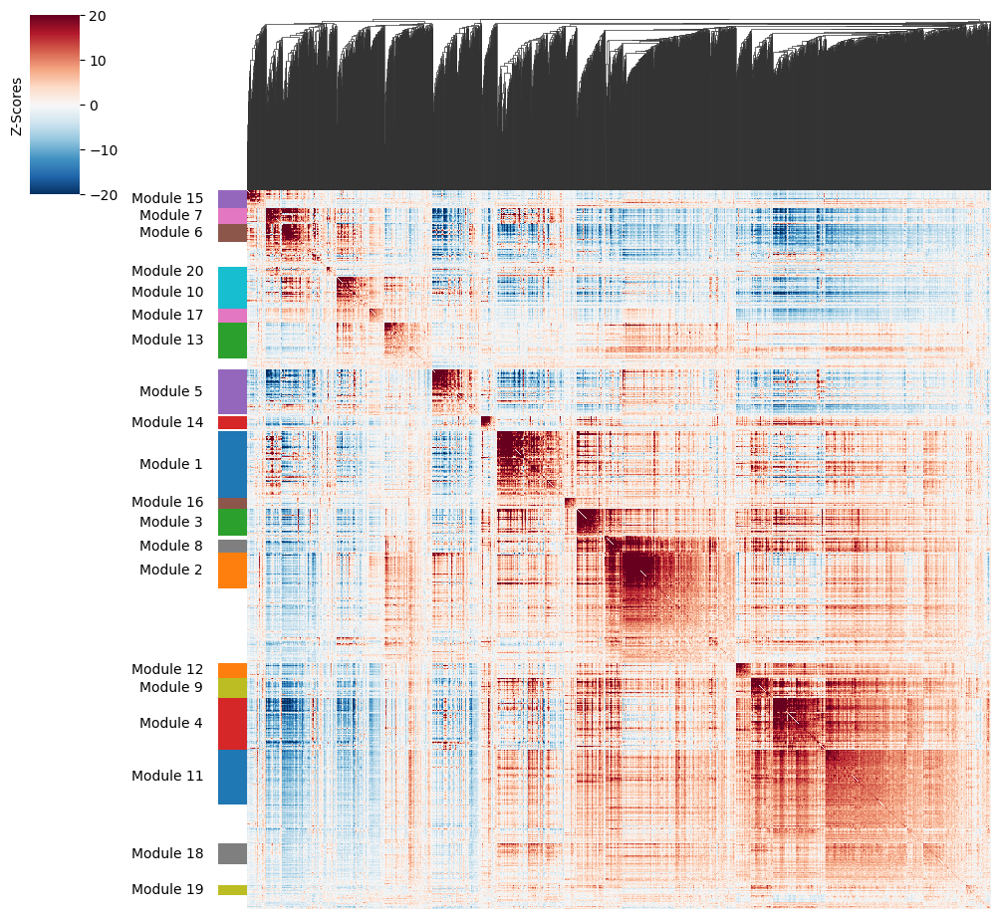

In [61]:
hs.plot_local_correlations(vmin=-20, vmax=20,)

In [62]:
module_scores = hotspot_obj.calculate_module_scores()

Computing scores for 20 modules...


100%|██████████| 20/20 [00:03<00:00,  5.88it/s]


In [63]:
module_cols = []
for c in module_scores.columns:
    key = f"Module {c}"
    tumor.obs[key] = module_scores[c]
    module_cols.append(key)

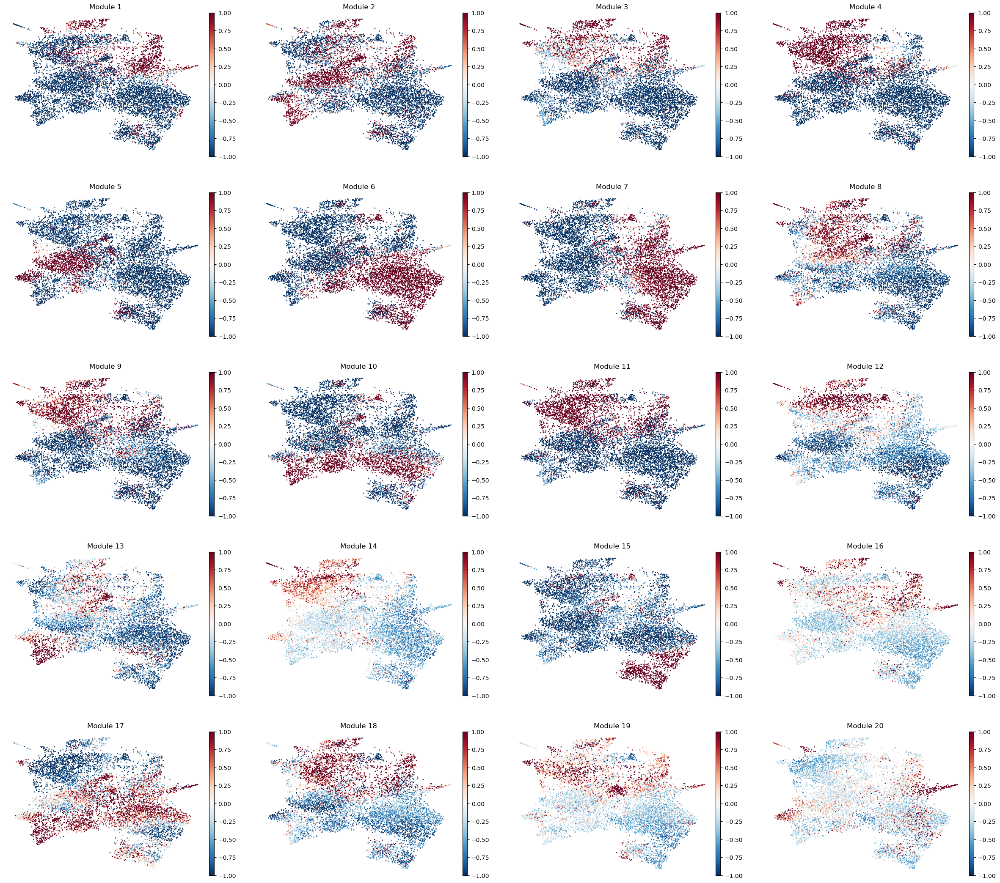

In [64]:
sc.pl.umap(tumor,cmap="RdBu_r", color=module_cols, frameon=False, vmin=-1, vmax=1)

In [65]:
n = 20  # you can change this number
score_cols = [f"Module {i}" for i in range(1, n + 1)]
print(score_cols)


['Module 1', 'Module 2', 'Module 3', 'Module 4', 'Module 5', 'Module 6', 'Module 7', 'Module 8', 'Module 9', 'Module 10', 'Module 11', 'Module 12', 'Module 13', 'Module 14', 'Module 15', 'Module 16', 'Module 17', 'Module 18', 'Module 19', 'Module 20']


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.360e-170 U_stat=6.141e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:5.549e-90 U_stat=1.025e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:4.947e-272 U_stat=2.190e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:4.388e-132 U_stat=7.934e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:5.104e-01 U_stat=2.061e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.418e-126 U_stat=3.369e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.559e-20 U_stat=2.591e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.917e-184 U_stat=5.546e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:7.626e-196 U_stat=5.058e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.562e-144 U_stat=3.458e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.203e-131 U_stat=7.956e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:3.163e-89 U_stat=1.029e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.140e-42 U_stat=1.367e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.555e-138 U_stat=7.615e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:9.231e-13 U_stat=2.476e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.205e-166 U_stat=6.305e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:2.112e-09 U_stat=2.415e+06


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:4.596e-127 U_stat=8.188e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.423e-211 U_stat=4.425e+05


/tmp/ipykernel_2255777/1921675809.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_2255777/1921675809.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  means = tumor_valid.groupby(site_col)[score].mean().round(2)
/tmp/ipykernel_2255777/1921675809.py:72: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  maxs  = tumor_valid.groupby(site_col)[score].max().round(2)


Core vs. Peri: Mann-Whitney-Wilcoxon test two-sided, P_val:1.607e-01 U_stat=2.171e+06


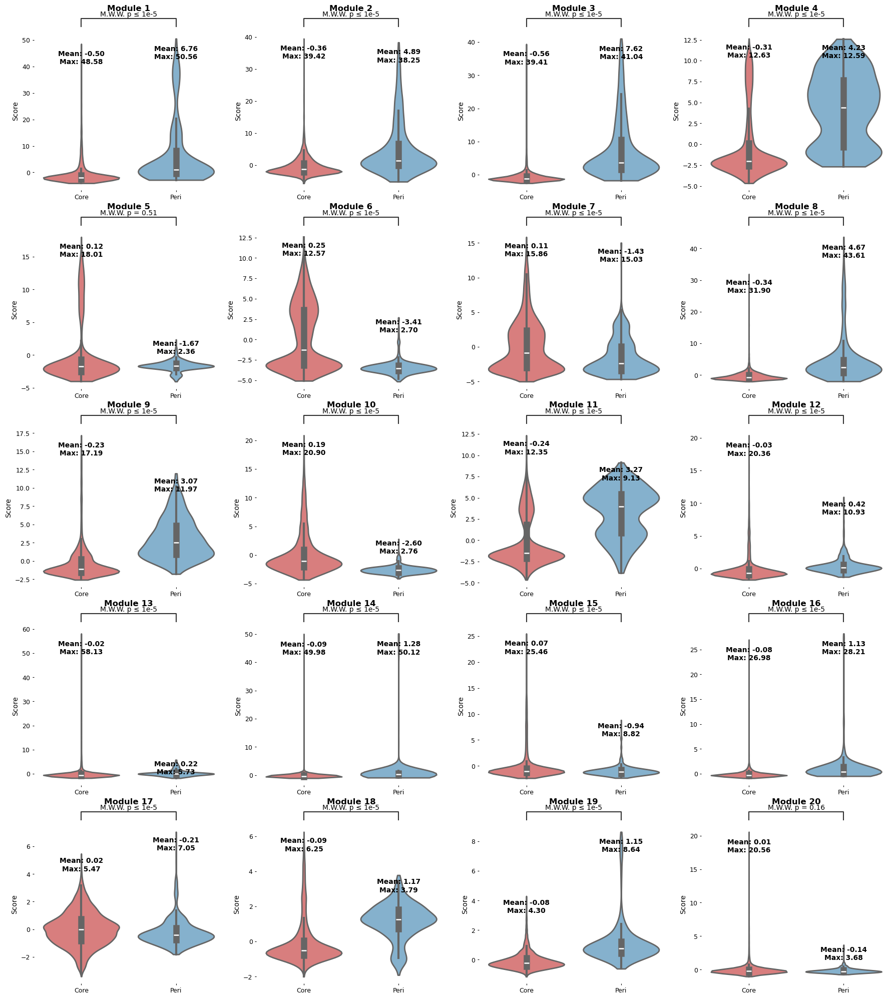

Plotted 20 modules: ['Module 1', 'Module 2', 'Module 3', 'Module 4', 'Module 5', 'Module 6', 'Module 7', 'Module 8', 'Module 9', 'Module 10', 'Module 11', 'Module 12', 'Module 13', 'Module 14', 'Module 15', 'Module 16', 'Module 17', 'Module 18', 'Module 19', 'Module 20']


In [66]:
# --- imports ---
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# Optional: use statannotations if installed for pretty p-value bars
try:
    from statannotations.Annotator import Annotator
    HAS_ANNOTATOR = True
except Exception:
    HAS_ANNOTATOR = False

# ----------------- PARAMETERS YOU CAN EDIT -----------------
n = 20  # << set the number of modules you want
module_prefix = "Module "  # e.g., "Module ", "Score ", etc.
site_col = "site"          # column that has "Core"/"Peri"
order_sites = ["Core", "Peri"]
palette = {"Core": "#e76f6f", "Peri": "#79b4d9"}
ncols = 4                  # change if you want more/fewer columns per row
figsize_per_plot = (4.5, 4.0)  # width, height per small subplot
# -----------------------------------------------------------

# Build the list of score columns based on n
score_cols = [f"{module_prefix}{i}" for i in range(1, n + 1)]

# Keep only the score columns that actually exist in tumor.obs
existing_scores = [c for c in score_cols if c in tumor.obs.columns]
if len(existing_scores) == 0:
    raise ValueError("None of the requested module columns exist in tumor.obs.")

# (Optional) ensure score columns are numeric
for c in existing_scores:
    tumor.obs[c] = pd.to_numeric(tumor.obs[c], errors="coerce")

# Filter to rows with valid site labels used in order_sites
tumor_valid = tumor.obs[tumor.obs[site_col].isin(order_sites)].copy()

# Set up the grid dynamically
nplots = len(existing_scores)
nrows = math.ceil(nplots / ncols)
fig, axes = plt.subplots(nrows, ncols, figsize=(figsize_per_plot[0]*ncols, figsize_per_plot[1]*nrows))
if isinstance(axes, np.ndarray):
    axes = axes.flatten()
else:
    axes = np.array([axes])

# Plot each module
for i, score in enumerate(existing_scores):
    ax = axes[i]

    # Violin plot
    sns.violinplot(
        data=tumor_valid,
        x=site_col,
        y=score,
        order=order_sites,
        palette=palette,
        ax=ax,
        linewidth=2,
        cut=0
    )

    # Compute stats
    core_vals = tumor_valid.loc[tumor_valid[site_col] == "Core", score].dropna()
    peri_vals = tumor_valid.loc[tumor_valid[site_col] == "Peri", score].dropna()

    # Means/Max per site
    means = tumor_valid.groupby(site_col)[score].mean().round(2)
    maxs  = tumor_valid.groupby(site_col)[score].max().round(2)

    # Add mean & max text inside each half
    for j, site in enumerate(order_sites):
        if site in means.index and site in maxs.index:
            y_max = tumor_valid.loc[tumor_valid[site_col] == site, score].max()
            if pd.notna(y_max):
                ax.text(
                    j, y_max * 0.95,
                    f"Mean: {means[site]:.2f}\nMax: {maxs[site]:.2f}",
                    ha='center', va='top', fontsize=10, weight='bold'
                )

    # Title
    ax.text(0.5, 1.12, f"{score}", fontsize=12, ha='center', va='bottom', transform=ax.transAxes, weight='bold')

    # P-value annotation
    if len(core_vals) > 0 and len(peri_vals) > 0:
        stat, pval = stats.mannwhitneyu(core_vals, peri_vals, alternative='two-sided')

        if HAS_ANNOTATOR:
            pairs = [("Core", "Peri")]
            annotator = Annotator(
                ax, pairs,
                data=tumor_valid, x=site_col, y=score, order=order_sites
            )
            annotator.configure(
                test='Mann-Whitney',
                text_format='simple',
                loc='outside',
                line_height=0.05,
                fontsize=10
            )
            annotator.apply_and_annotate()
        else:
            # Fallback: put p-value as text above the axes
            ax.text(0.5, 1.02, f"p = {pval:.2e}", transform=ax.transAxes,
                    ha='center', va='bottom', fontsize=10)

    # Axes styling
    ax.set_xlabel("")
    ax.set_ylabel("Score", fontsize=10)
    ax.tick_params(length=2, labelsize=9)
    for spine in ax.spines.values():
        spine.set_visible(False)

# Hide any unused axes if nplots doesn't fill the grid
for j in range(nplots, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout(h_pad=0.8, w_pad=0.6)
plt.show()

print(f"Plotted {nplots} modules:", existing_scores)
